In [1]:
# AeroCNN-II
import os
import sys
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import SimpleImputer

import datetime
%matplotlib inline

In [2]:
#from tensorflow.python.client import device_lib
#device_lib.list_local_devices()

In [3]:
#mirrored_strategy = tf.distribute.MirroredStrategy(["/GPU:0","/GPU:1", "/GPU:2"], cross_device_ops = tf.distribute.HierarchicalCopyAllReduce())

In [4]:
n_kernel=100
l2Regularizer=1e-09
kernel_size1 = 3
kernel_size2 = 3
#kernel_size3 = 5
n_grid = 100
strides = 1
input_size = 100
lr=5e-04
batch_size=20

In [5]:
alpha = np.linspace(-10,20,16).reshape((16,1))

In [6]:
aa = np.zeros((16*133,1))
for i in range(0, 133):
    aa[16*i:16*(i+1), :] = alpha[:,:]

In [7]:
aa = aa.reshape((133, 16, 1, 1))

In [8]:
os.chdir('D:\\AeroCNN2Inputs')

In [9]:
origin = "D:\\AeroCNN2Inputs2"
origin_data = "D:\\AirfoilClCdCoordinates_out\\AirfoilClCdCoordinates_out"
origin_poisson = "D:\\CNN_poisson_files\\poisson\\bc2"

In [10]:
folders_orig = os.listdir(origin)
folders = [file for file in folders_orig if file.endswith('.csv')]

In [11]:
image_df = pd.DataFrame()
for i in range(1, 134):
    for j in range(0, alpha.shape[0]):
        csv_file_name = origin + '\\airfoil' + str(i) + "_alpha"+ str(int(alpha[j])) + ".csv"
        data = pd.read_csv(csv_file_name, header=None)
        image_df = pd.concat([image_df, data], axis=0)

In [12]:
image_np = image_df.iloc[:, :].values

In [13]:
image = image_np.reshape((133, 16, n_grid, n_grid))

In [14]:
image = 1-image/100

In [15]:
field_df = pd.DataFrame()
for i in range(1, 134):
    for j in range(0, alpha.shape[0]):
        csv_file_name = origin_poisson + '\\airfoil' + str(i) + "_alpha"+ str(int(alpha[j])) + ".csv"
        data = pd.read_csv(csv_file_name, header=None)
        field_df = pd.concat([field_df, data], axis=0)

In [16]:
field_np = field_df.iloc[:, :].values

In [17]:
imr = SimpleImputer(missing_values=np.nan, strategy='mean')
imr = imr.fit(field_np)
imputed_field = imr.transform(field_np)

In [18]:
field = imputed_field.reshape((133, 16, n_grid+1, n_grid+1))

In [19]:
field_nor = (field-np.min(field))/(np.max(field)-np.min(field))

In [20]:
file_name = origin_data + "\\AirfoilIndexList.xlsx"
airfoilName_df = pd.read_excel(file_name)
geometry_orig = airfoilName_df.iloc[:, 1].values

In [21]:
geometry = np.zeros((133*16,1))
geometry = geometry.astype(np.string_)
for i in geometry_orig:
    index_ = np.where(geometry_orig==i)
    for j in range(0,16):
        geometry[16*index_[0]+j,:] = np.asarray(i)

In [22]:
geometry.shape

(2128, 1)

In [23]:
geometry = geometry.reshape((133, 16, 1))

In [24]:
x_train, x_test, aa_train, aa_test, geo_train, geo_test, y_train, y_test = train_test_split(image, aa, geometry, field_nor, test_size=0.3, random_state=1)

In [25]:
x_train = x_train.reshape((x_train.shape[0]*x_train.shape[1], x_train.shape[2], x_train.shape[3], 1))
x_test = x_test.reshape((x_test.shape[0]*x_test.shape[1], x_test.shape[2], x_test.shape[3], 1))
aa_train = aa_train.reshape((aa_train.shape[0]*aa_train.shape[1], aa_train.shape[2], aa_train.shape[3]))
aa_test = aa_test.reshape((aa_test.shape[0]*aa_test.shape[1], aa_test.shape[2], aa_test.shape[3]))
geo_train = geo_train.reshape((geo_train.shape[0]*geo_train.shape[1], geo_train.shape[2]))
geo_test = geo_test.reshape((geo_test.shape[0]*geo_test.shape[1], geo_test.shape[2]))
y_train = y_train.reshape((y_train.shape[0]*y_train.shape[1], y_train.shape[2], y_train.shape[3], 1))
y_test = y_test.reshape((y_test.shape[0]*y_test.shape[1], y_test.shape[2], y_test.shape[3], 1))

In [26]:
tf.keras.backend.set_image_data_format('channels_last')

In [27]:
#with mirrored_strategy.scope():
input_image = tf.keras.Input(shape=(n_grid, n_grid, 1))
#reshape0 = tf.keras.layers.Reshape(())

x_conv = tf.keras.layers.Conv2D(n_kernel, (kernel_size1, kernel_size1), strides=(strides, strides),
                                activation='relu', padding='same',
                                kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                name='Conv2DLayer1')(input_image)
x_ = tf.keras.layers.MaxPooling2D((2,2))(x_conv)
x_conv = tf.keras.layers.Conv2D(n_kernel*2, (kernel_size1, kernel_size1), strides=(strides, strides),
                                activation='relu', padding='same',
                                kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                name='Conv2DLayer2')(x_)
x_ = tf.keras.layers.MaxPooling2D((2,2))(x_conv)

x_conv = tf.keras.layers.Conv2DTranspose(n_kernel*2, (kernel_size1, kernel_size1),
                                         strides=(2,2),
                                         activation='relu', padding='same',
                                         kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                         name='Conv2DTLayer1')(x_)
x_conv = tf.keras.layers.Conv2DTranspose(n_kernel, (kernel_size1, kernel_size1),
                                         strides=(2,2),
                                         activation='relu', padding='same',
                                         kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                         name='Conv2DTLayer2')(x_conv)

x_conv = tf.keras.layers.Conv2D(1, (1, 1), strides=(strides, strides),
                                activation='relu', padding='same',
                                kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                name='Conv2DLayerFinal')(x_conv)
x_ = tf.keras.layers.Flatten()(x_conv)
x_ = tf.keras.layers.Dense(units=(n_grid+1)**2, activation='linear', name='FCLayer1',
                           kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer))(x_)
#x_ = tf.keras.layers.Dense(units=101*101, activation='linear', name='outputLayer')(x_)
output_data = tf.keras.layers.Reshape((n_grid+1,n_grid+1,1))(x_)

# AeroCNN-II
model = tf.keras.Model(input_image, output_data)

In [28]:
#with mirrored_strategy.scope():
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 100, 100, 1)]     0         
                                                                 
 Conv2DLayer1 (Conv2D)       (None, 100, 100, 100)     1000      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 50, 50, 100)      0         
 )                                                               
                                                                 
 Conv2DLayer2 (Conv2D)       (None, 50, 50, 200)       180200    
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 25, 25, 200)      0         
 2D)                                                             
                                                                 
 Conv2DTLayer1 (Conv2DTransp  (None, 50, 50, 200)      360200

In [29]:
#with mirrored_strategy.scope():
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=lr),
              loss = tf.keras.losses.MeanSquaredError(),
              metrics=[tf.keras.metrics.RootMeanSquaredError(name="rmse")])

In [30]:
#with mirrored_strategy.scope():
start = datetime.datetime.now()
history = model.fit(x_train, y_train, epochs=5000, shuffle=True, batch_size=batch_size,
                    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='loss', patience=100)])
end = datetime.datetime.now()

Epoch 1/5000
75/75 [==============================] - 8s 32ms/step - loss: 0.0527 - rmse: 0.2295
Epoch 2/5000
75/75 [==============================] - 2s 30ms/step - loss: 0.0104 - rmse: 0.1020
Epoch 3/5000
75/75 [==============================] - 2s 30ms/step - loss: 4.8255e-04 - rmse: 0.0217
Epoch 4/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.9884e-04 - rmse: 0.0170
Epoch 5/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.4905e-04 - rmse: 0.0154
Epoch 6/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.2153e-04 - rmse: 0.0145
Epoch 7/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.8039e-04 - rmse: 0.0130
Epoch 8/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.3336e-04 - rmse: 0.0111
Epoch 9/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.5798e-04 - rmse: 0.0121
Epoch 10/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.4480e-04 - rmse: 0.01

75/75 [==============================] - 2s 30ms/step - loss: 6.6955e-05 - rmse: 0.0075
Epoch 82/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.2967e-05 - rmse: 0.0079
Epoch 83/5000
75/75 [==============================] - 2s 30ms/step - loss: 5.2018e-05 - rmse: 0.0065
Epoch 84/5000
75/75 [==============================] - 2s 30ms/step - loss: 5.7549e-05 - rmse: 0.0069
Epoch 85/5000
75/75 [==============================] - 2s 30ms/step - loss: 5.4723e-05 - rmse: 0.0067
Epoch 86/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.1822e-05 - rmse: 0.0078
Epoch 87/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0871e-04 - rmse: 0.0099
Epoch 88/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.7712e-05 - rmse: 0.0076
Epoch 89/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.2546e-05 - rmse: 0.0072
Epoch 90/5000
75/75 [==============================] - 2s 30ms/step - loss: 9.7399e-05 - rmse: 0

75/75 [==============================] - 2s 30ms/step - loss: 2.8602e-05 - rmse: 0.0043
Epoch 161/5000
75/75 [==============================] - 2s 31ms/step - loss: 3.6562e-05 - rmse: 0.0052
Epoch 162/5000
75/75 [==============================] - 2s 30ms/step - loss: 3.0224e-05 - rmse: 0.0045
Epoch 163/5000
75/75 [==============================] - 2s 30ms/step - loss: 5.4368e-05 - rmse: 0.0067
Epoch 164/5000
75/75 [==============================] - 2s 30ms/step - loss: 5.3677e-05 - rmse: 0.0066
Epoch 165/5000
75/75 [==============================] - 2s 31ms/step - loss: 4.0411e-05 - rmse: 0.0055
Epoch 166/5000
75/75 [==============================] - 2s 30ms/step - loss: 3.1986e-05 - rmse: 0.0047
Epoch 167/5000
75/75 [==============================] - 2s 30ms/step - loss: 3.7097e-05 - rmse: 0.0052
Epoch 168/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.3138e-05 - rmse: 0.0037
Epoch 169/5000
75/75 [==============================] - 2s 31ms/step - loss: 2.1947e-05 

75/75 [==============================] - 2s 30ms/step - loss: 1.8020e-05 - rmse: 0.0030
Epoch 240/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.1947e-05 - rmse: 0.0036
Epoch 241/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.7593e-05 - rmse: 0.0029
Epoch 242/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.7981e-05 - rmse: 0.0044
Epoch 243/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.8710e-05 - rmse: 0.0044
Epoch 244/5000
75/75 [==============================] - 2s 30ms/step - loss: 3.3564e-05 - rmse: 0.0050
Epoch 245/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.4367e-05 - rmse: 0.0074
Epoch 246/5000
75/75 [==============================] - 2s 30ms/step - loss: 3.2027e-05 - rmse: 0.0048
Epoch 247/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.8559e-05 - rmse: 0.0031
Epoch 248/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.4143e-05 

75/75 [==============================] - 2s 30ms/step - loss: 1.2328e-05 - rmse: 0.0020
Epoch 319/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.7125e-05 - rmse: 0.0030
Epoch 320/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.8765e-05 - rmse: 0.0032
Epoch 321/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.4804e-05 - rmse: 0.0026
Epoch 322/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.4100e-05 - rmse: 0.0040
Epoch 323/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.6272e-05 - rmse: 0.0043
Epoch 324/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.5505e-05 - rmse: 0.0042
Epoch 325/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.8337e-05 - rmse: 0.0032
Epoch 326/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.7015e-05 - rmse: 0.0043
Epoch 327/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.4467e-05 

75/75 [==============================] - 2s 30ms/step - loss: 1.4730e-05 - rmse: 0.0027
Epoch 398/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.4822e-05 - rmse: 0.0027
Epoch 399/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.9400e-05 - rmse: 0.0047
Epoch 400/5000
75/75 [==============================] - 2s 30ms/step - loss: 4.3193e-05 - rmse: 0.0060
Epoch 401/5000
75/75 [==============================] - 2s 31ms/step - loss: 1.9822e-05 - rmse: 0.0035
Epoch 402/5000
75/75 [==============================] - 2s 30ms/step - loss: 3.2070e-05 - rmse: 0.0050
Epoch 403/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.2474e-05 - rmse: 0.0022
Epoch 404/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.0474e-05 - rmse: 0.0036
Epoch 405/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.5222e-05 - rmse: 0.0028
Epoch 406/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0022e-05 

75/75 [==============================] - 2s 30ms/step - loss: 1.5538e-05 - rmse: 0.0029
Epoch 477/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0450e-05 - rmse: 0.0019
Epoch 478/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0556e-05 - rmse: 0.0019
Epoch 479/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.4095e-05 - rmse: 0.0027
Epoch 480/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0826e-05 - rmse: 0.0020
Epoch 481/5000
75/75 [==============================] - 2s 30ms/step - loss: 8.5499e-06 - rmse: 0.0013
Epoch 482/5000
75/75 [==============================] - 2s 30ms/step - loss: 9.7220e-06 - rmse: 0.0017
Epoch 483/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0505e-05 - rmse: 0.0019
Epoch 484/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0471e-05 - rmse: 0.0019
Epoch 485/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0329e-05 

75/75 [==============================] - 2s 30ms/step - loss: 3.2962e-05 - rmse: 0.0052
Epoch 556/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.6062e-05 - rmse: 0.0044
Epoch 557/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0908e-05 - rmse: 0.0022
Epoch 558/5000
75/75 [==============================] - 2s 30ms/step - loss: 9.5852e-06 - rmse: 0.0018
Epoch 559/5000
75/75 [==============================] - 2s 30ms/step - loss: 9.6831e-06 - rmse: 0.0019
Epoch 560/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0552e-05 - rmse: 0.0021
Epoch 561/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.1379e-05 - rmse: 0.0039
Epoch 562/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.1597e-05 - rmse: 0.0023
Epoch 563/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.1216e-05 - rmse: 0.0022
Epoch 564/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.2815e-05 

75/75 [==============================] - 2s 30ms/step - loss: 8.1440e-06 - rmse: 0.0015
Epoch 635/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.9335e-06 - rmse: 0.0015
Epoch 636/5000
75/75 [==============================] - 2s 30ms/step - loss: 9.3174e-06 - rmse: 0.0019
Epoch 637/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.2797e-06 - rmse: 0.0012
Epoch 638/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.5650e-06 - rmse: 0.0014
Epoch 639/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.3588e-06 - rmse: 0.0013
Epoch 640/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.1445e-05 - rmse: 0.0024
Epoch 641/5000
75/75 [==============================] - 2s 30ms/step - loss: 5.5775e-05 - rmse: 0.0071
Epoch 642/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.9481e-05 - rmse: 0.0049
Epoch 643/5000
75/75 [==============================] - 2s 30ms/step - loss: 8.7386e-06 

75/75 [==============================] - 2s 30ms/step - loss: 1.4099e-05 - rmse: 0.0030
Epoch 714/5000
75/75 [==============================] - 2s 30ms/step - loss: 9.8973e-06 - rmse: 0.0022
Epoch 715/5000
75/75 [==============================] - 2s 30ms/step - loss: 8.2643e-06 - rmse: 0.0017
Epoch 716/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.4565e-05 - rmse: 0.0031
Epoch 717/5000
75/75 [==============================] - 2s 30ms/step - loss: 8.4347e-06 - rmse: 0.0018
Epoch 718/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.4494e-06 - rmse: 0.0011
Epoch 719/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.4133e-05 - rmse: 0.0030
Epoch 720/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0681e-05 - rmse: 0.0023
Epoch 721/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.3061e-05 - rmse: 0.0028
Epoch 722/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0745e-05 

75/75 [==============================] - 2s 30ms/step - loss: 5.8037e-06 - rmse: 0.0010
Epoch 793/5000
75/75 [==============================] - 2s 30ms/step - loss: 5.7028e-06 - rmse: 9.5324e-04
Epoch 794/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.4749e-06 - rmse: 0.0013
Epoch 795/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.0726e-06 - rmse: 0.0015
Epoch 796/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6828e-06 - rmse: 0.0014
Epoch 797/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.1802e-06 - rmse: 0.0012
Epoch 798/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.3233e-06 - rmse: 0.0012
Epoch 799/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0919e-05 - rmse: 0.0025
Epoch 800/5000
75/75 [==============================] - 2s 30ms/step - loss: 8.4894e-06 - rmse: 0.0019
Epoch 801/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.6297e

75/75 [==============================] - 2s 30ms/step - loss: 7.2584e-06 - rmse: 0.0017
Epoch 872/5000
75/75 [==============================] - 2s 30ms/step - loss: 5.5931e-06 - rmse: 0.0011
Epoch 873/5000
75/75 [==============================] - 2s 30ms/step - loss: 5.2820e-06 - rmse: 9.5070e-04
Epoch 874/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.8904e-06 - rmse: 0.0016
Epoch 875/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0817e-05 - rmse: 0.0025
Epoch 876/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.8903e-06 - rmse: 0.0019
Epoch 877/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.4185e-06 - rmse: 0.0017
Epoch 878/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.7229e-05 - rmse: 0.0036
Epoch 879/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.9957e-05 - rmse: 0.0051
Epoch 880/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.1161e

75/75 [==============================] - 2s 30ms/step - loss: 7.5060e-06 - rmse: 0.0019
Epoch 951/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6298e-06 - rmse: 0.0016
Epoch 952/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.7728e-06 - rmse: 0.0019
Epoch 953/5000
75/75 [==============================] - 2s 30ms/step - loss: 4.8048e-06 - rmse: 8.9097e-04
Epoch 954/5000
75/75 [==============================] - 2s 30ms/step - loss: 5.3287e-06 - rmse: 0.0012
Epoch 955/5000
75/75 [==============================] - 2s 30ms/step - loss: 5.5683e-06 - rmse: 0.0013
Epoch 956/5000
75/75 [==============================] - 2s 30ms/step - loss: 5.8220e-06 - rmse: 0.0014
Epoch 957/5000
75/75 [==============================] - 2s 30ms/step - loss: 5.5641e-06 - rmse: 0.0013
Epoch 958/5000
75/75 [==============================] - 2s 30ms/step - loss: 5.6420e-06 - rmse: 0.0013
Epoch 959/5000
75/75 [==============================] - 2s 30ms/step - loss: 5.5452e

75/75 [==============================] - 2s 30ms/step - loss: 8.4342e-06 - rmse: 0.0022
Epoch 1030/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.2992e-05 - rmse: 0.0031
Epoch 1031/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.4174e-06 - rmse: 0.0017
Epoch 1032/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.1076e-06 - rmse: 0.0019
Epoch 1033/5000
75/75 [==============================] - 2s 30ms/step - loss: 8.1588e-06 - rmse: 0.0021
Epoch 1034/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0587e-05 - rmse: 0.0026
Epoch 1035/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.9992e-06 - rmse: 0.0018
Epoch 1036/5000
75/75 [==============================] - 2s 30ms/step - loss: 8.2930e-06 - rmse: 0.0022
Epoch 1037/5000
75/75 [==============================] - 2s 30ms/step - loss: 8.6681e-06 - rmse: 0.0022
Epoch 1038/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.

In [31]:
time = end - start
print("Training time:", time)

Training time: 0:39:37.645565


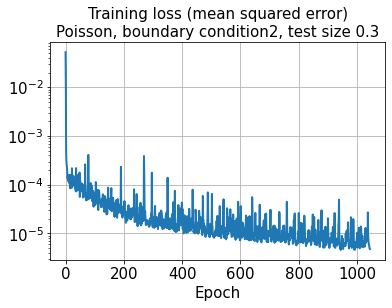

In [32]:
hist = history.history
plt.plot(hist['loss'], lw=2)
plt.title('Training loss (mean squared error)\nPoisson, boundary condition2, test size 0.3', size=15)
plt.xlabel('Epoch', size=15)
plt.yscale('log')
#plt.ylim([5e-5, 1e-1])
plt.tick_params(axis='both', which='major', labelsize=15)
plt.grid()
plt.show()

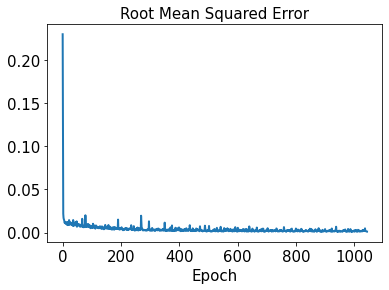

In [33]:
plt.plot(hist['rmse'], lw=2)
plt.title('Root Mean Squared Error', size=15)
plt.xlabel('Epoch', size=15)
plt.tick_params(axis='both', which='major', labelsize=15)
plt.show()

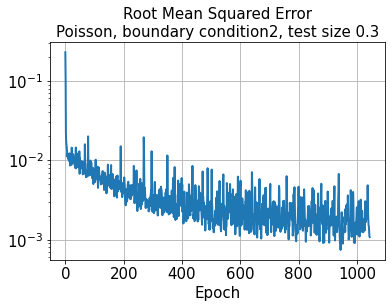

In [34]:
plt.plot(hist['rmse'], lw=2)
plt.title('Root Mean Squared Error\nPoisson, boundary condition2, test size 0.3', size=15)
plt.xlabel('Epoch', size=15)
plt.yscale('log')
plt.tick_params(axis='both', which='major', labelsize=15)
plt.grid()
plt.show()

In [35]:
#with mirrored_strategy.scope():
test_results = model.evaluate(x_train)

47/47 [==============================] - 0s 3ms/step - loss: 3.6238e-06 - rmse: 0.0000e+00


In [36]:
#with mirrored_strategy.scope():
decoded_train = model.predict(x_train)

47/47 [==============================] - 1s 11ms/step


In [37]:
#with mirrored_strategy.scope():
decoded_test = model.predict(x_test)

20/20 [==============================] - 0s 10ms/step


In [38]:
error_train_abs = np.abs(decoded_train - y_train)

In [39]:
error_test_abs = np.abs(decoded_test - y_test)

In [40]:
error_train_Cl_abs = np.abs(decoded_train[:,0,:] - y_train[:,0,:])

In [41]:
error_train_Cd_abs = np.abs(decoded_train[:,1,:] - y_train[:,1,:])

In [42]:
error_test_Cl_abs = np.abs(decoded_test[:,0,:] - y_test[:,0,:])

In [43]:
error_test_Cd_abs = np.abs(decoded_test[:,1,:] - y_test[:,1,:])

In [44]:
os.chdir("D:\\TrainedModels\\20221027")
model.save('Poisson_bc2_100kernel_2by2MaxPooling_2CNNlayer_testSize0.3.h5',
           overwrite=True, include_optimizer=True, save_format='h5')

In [45]:
l2_error_train = np.sqrt(np.sum((decoded_train - y_train)**2) / np.sum(y_train**2))
print(l2_error_train)

0.002582672392435454


In [46]:
l2_error_test = np.sqrt(np.sum((decoded_test - y_test)**2) / np.sum(y_test**2))
print(l2_error_test)

0.008157409247532684


In [47]:
l2_error_train_list = []
for i in range(0, len(aa_train)):
    l2_error_train_data = np.sqrt(np.sum((decoded_train[i] - y_train[i])**2) / np.sum(y_train[i]**2))
    l2_error_train_list.append(l2_error_train_data)
print(l2_error_train_list)

[0.0032265335175193344, 0.003252199425524015, 0.0027879267151058665, 0.0032683403627590257, 0.0022244281898697632, 0.0027001603863053263, 0.0015329107462766721, 0.001303750814331098, 0.0011801633093260924, 0.0011759393216603236, 0.001911379474039342, 0.002289356737758834, 0.002093055889864823, 0.0030181006096828156, 0.0037680688243621006, 0.003453020764168903, 0.003044804082042375, 0.002726943182396958, 0.0019634380574937516, 0.001529083420534623, 0.001982704233081036, 0.0016773257426225174, 0.0011746963233580726, 0.001142196320504259, 0.0009765036230335222, 0.0015484920624385477, 0.0022910551224277803, 0.0028035688325344934, 0.0019155744786735279, 0.002719428709217648, 0.002887535611197234, 0.003836370149680998, 0.00362226159145819, 0.003951941007289628, 0.003368736746197503, 0.00347485478601933, 0.00301708878843066, 0.0025019730164345527, 0.0015395477224579219, 0.0015091338340252711, 0.001049174377174742, 0.001925744004910554, 0.0024628487635776405, 0.002967451375685185, 0.0026159689

In [48]:
l2_error_test_list = []
for i in range(0, len(aa_test)):
    l2_error_test_data = np.sqrt(np.sum((decoded_test[i] - y_test[i])**2) / np.sum(y_test[i]**2))
    l2_error_test_list.append(l2_error_test_data)
print(l2_error_test_list)

[0.0033049220490842172, 0.0038036894996939835, 0.0026721243054929093, 0.002439011989718951, 0.00287932662622944, 0.0024047855219578, 0.001240813230229198, 0.0011383478534222739, 0.0016152601328481408, 0.0018021742047205863, 0.002214520057051004, 0.0027201518511581688, 0.002638944279516419, 0.0031253172690558187, 0.0020058667133604304, 0.002675673044437614, 0.001593967151007718, 0.0013930910832786574, 0.0016814821763297958, 0.0022653958087479665, 0.0013761311054287177, 0.0018060254429662875, 0.0018982751076653843, 0.005299431703618745, 0.008957316513032741, 0.006368505991667668, 0.005202457263215647, 0.006132591221508126, 0.005055074373318592, 0.006056802556344425, 0.0031574113484476706, 0.004393655599407085, 0.0044940574279668305, 0.004280956264878029, 0.003226015035252974, 0.001459113693339708, 0.0034817622603292428, 0.0014728848260918371, 0.0010975337485676045, 0.0013220611691534022, 0.0014054481436836896, 0.0025771146390914045, 0.0025568295876511587, 0.002855194784472934, 0.00309281

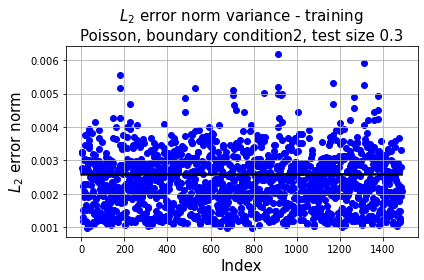

In [49]:
plt.plot(np.linspace(1, aa_train.shape[0], aa_train.shape[0]),
         l2_error_train*np.ones(aa_train.shape[0],), 'k', lw=2.5)
plt.scatter(np.linspace(1, aa_train.shape[0], aa_train.shape[0]), l2_error_train_list, c='b')
plt.xlabel('Index', fontsize=15)
plt.ylabel('$L_2$ error norm', fontsize=15)
plt.title('$L_2$ error norm variance - training\nPoisson, boundary condition2, test size 0.3', fontsize=15)
plt.grid()
plt.tight_layout()
plt.show()

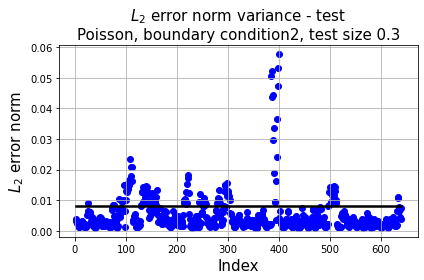

In [50]:
plt.plot(np.linspace(1, aa_test.shape[0], aa_test.shape[0]),
         l2_error_test*np.ones(aa_test.shape[0],), 'k', lw=2.5)
plt.scatter(np.linspace(1, aa_test.shape[0], aa_test.shape[0]), l2_error_test_list, c='b')
plt.xlabel('Index', fontsize=15)
plt.ylabel('$L_2$ error norm', fontsize=15)
plt.title('$L_2$ error norm variance - test\nPoisson, boundary condition2, test size 0.3', fontsize=15)
plt.grid()
plt.tight_layout()
plt.show()

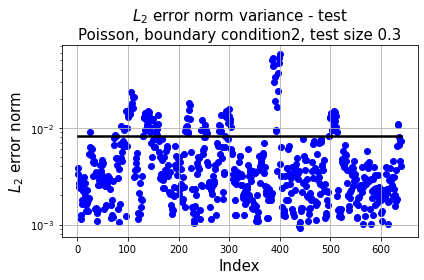

In [51]:
plt.plot(np.linspace(1, aa_test.shape[0], aa_test.shape[0]),
         l2_error_test*np.ones(aa_test.shape[0],), 'k', lw=2.5)
plt.scatter(np.linspace(1, aa_test.shape[0], aa_test.shape[0]), l2_error_test_list, c='b')
plt.xlabel('Index', fontsize=15)
plt.ylabel('$L_2$ error norm', fontsize=15)
plt.yscale('log')
plt.title('$L_2$ error norm variance - test\nPoisson, boundary condition2, test size 0.3', fontsize=15)
plt.grid()
plt.tight_layout()
plt.show()

In [52]:
os.chdir("D:\\CNN_poisson_files\\images\\testSize0.3")

In [53]:
n_grid=101

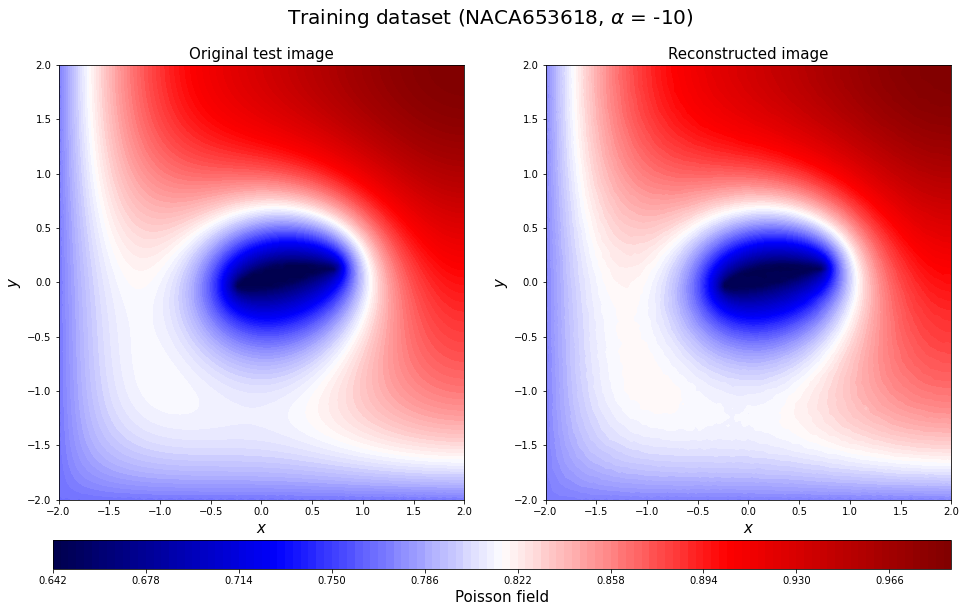

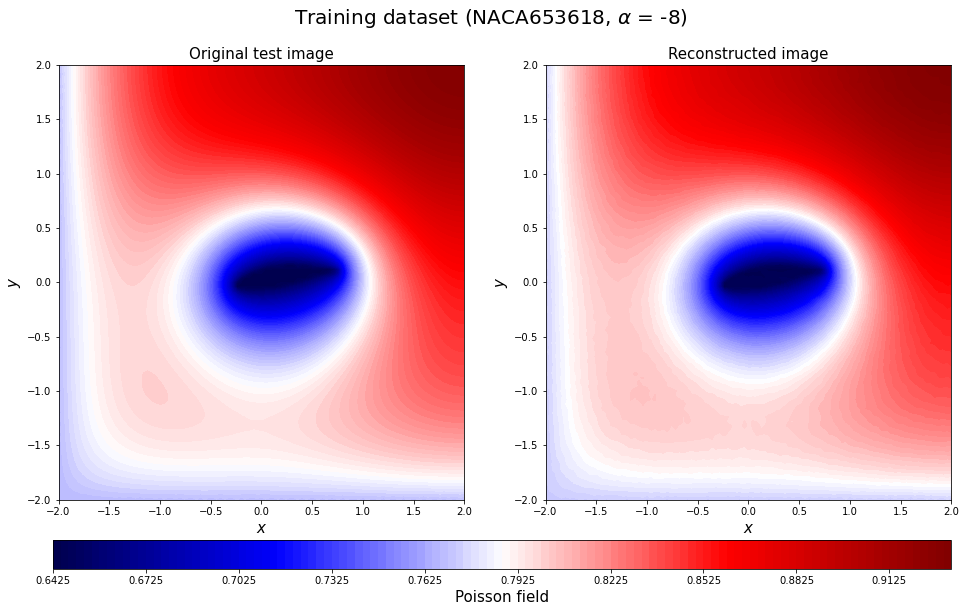

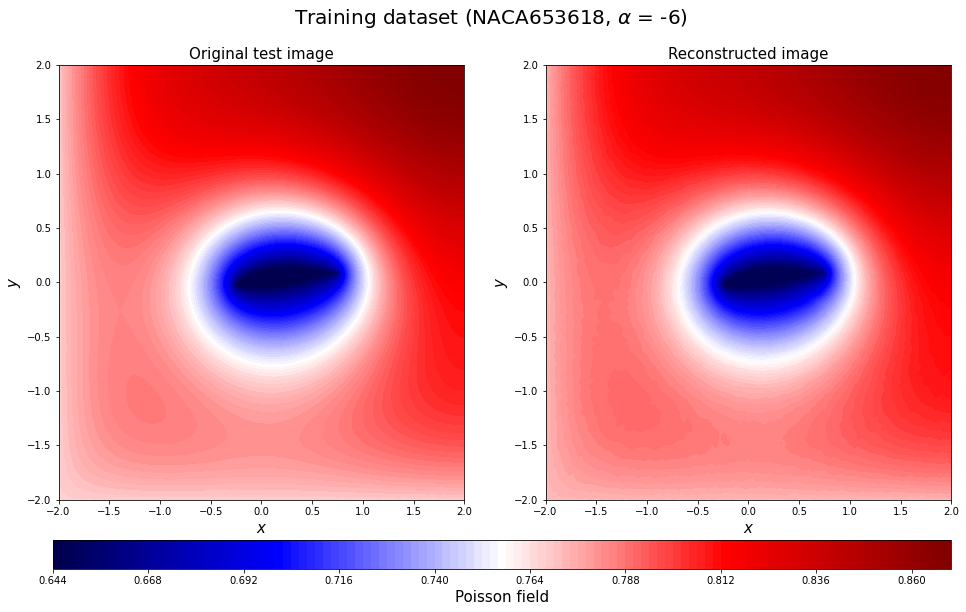

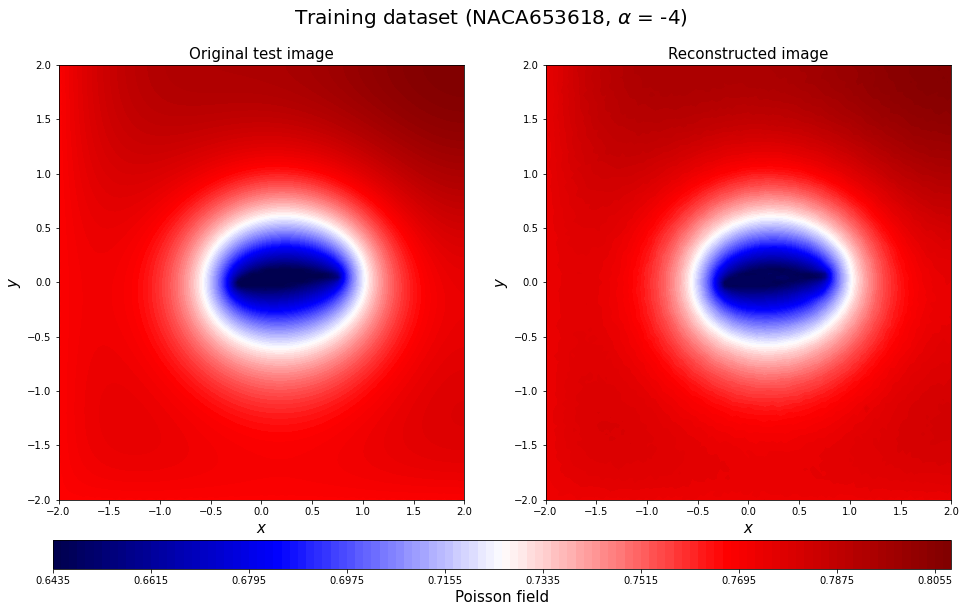

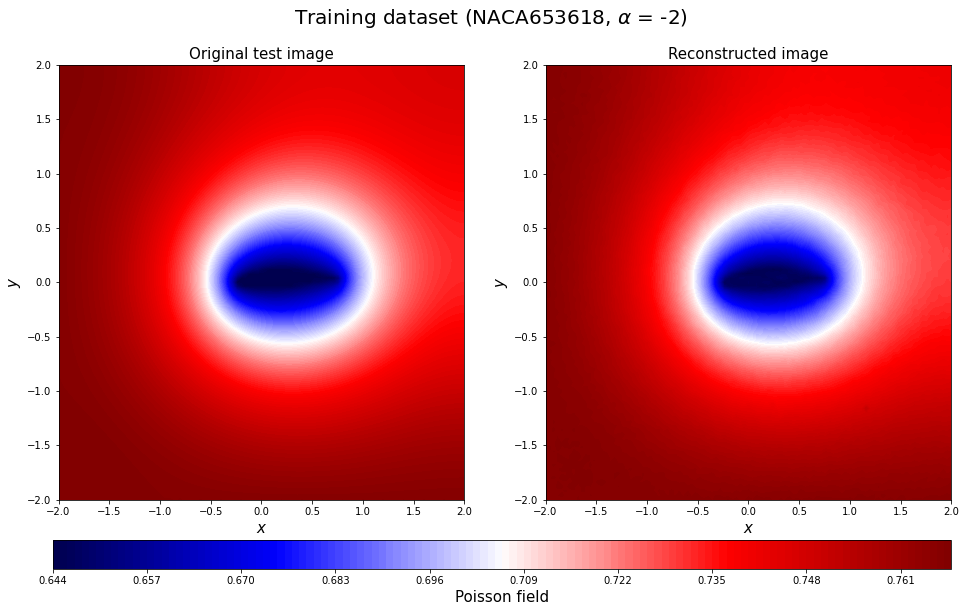

...

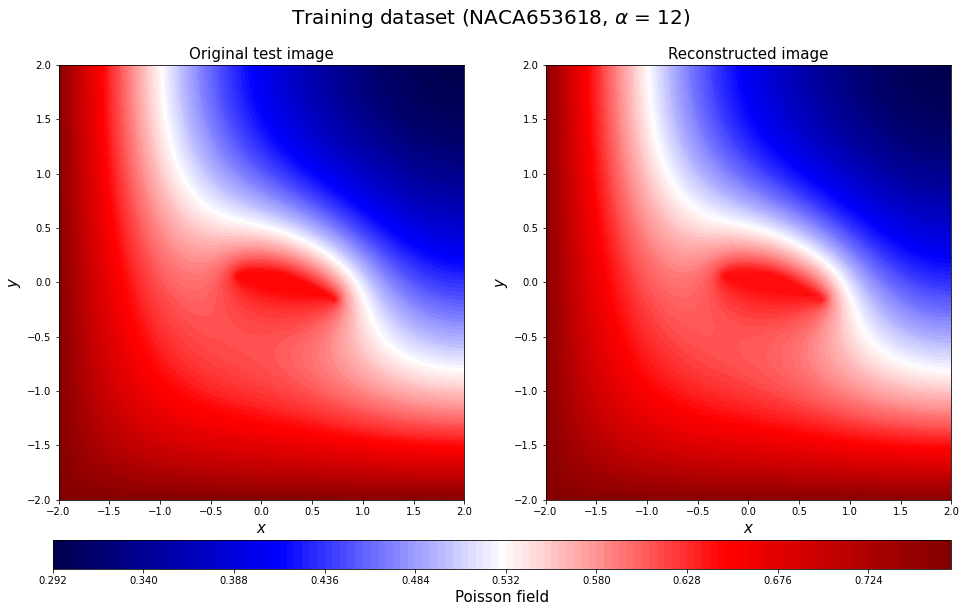

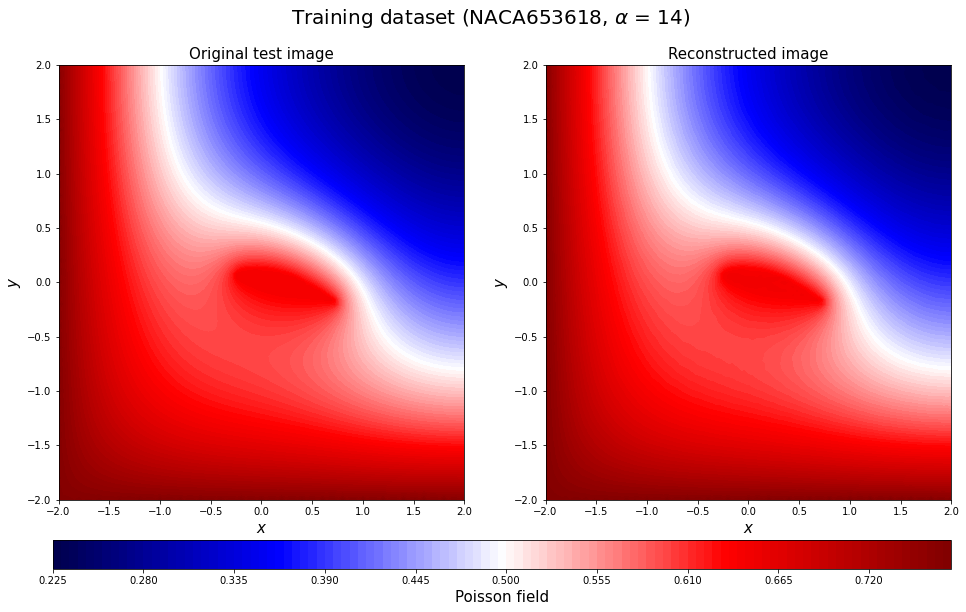

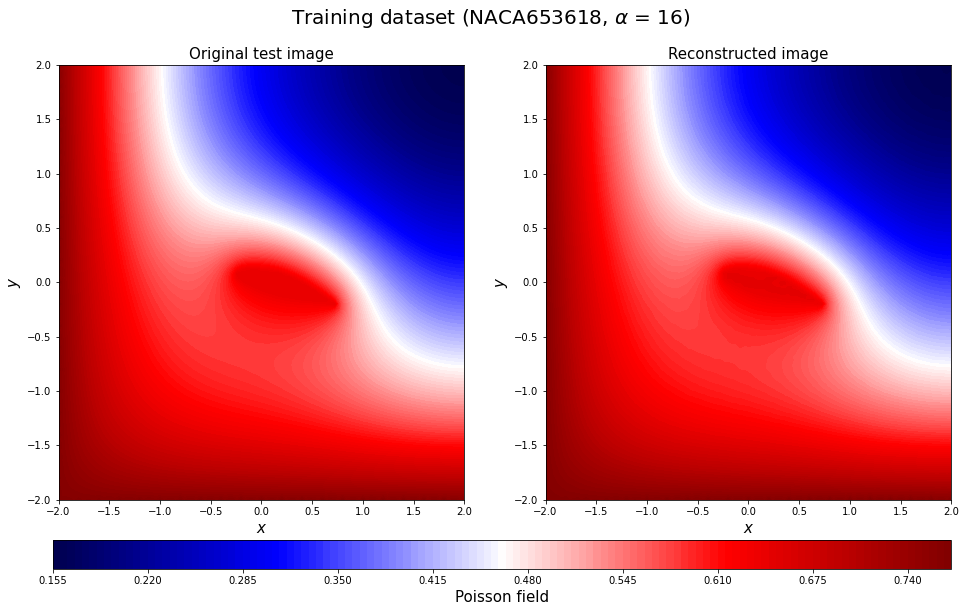

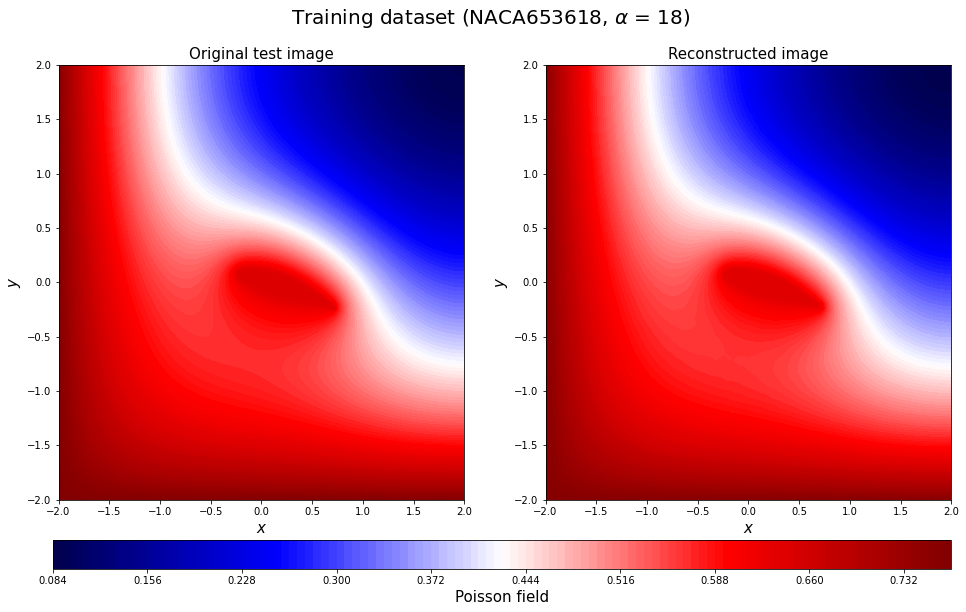

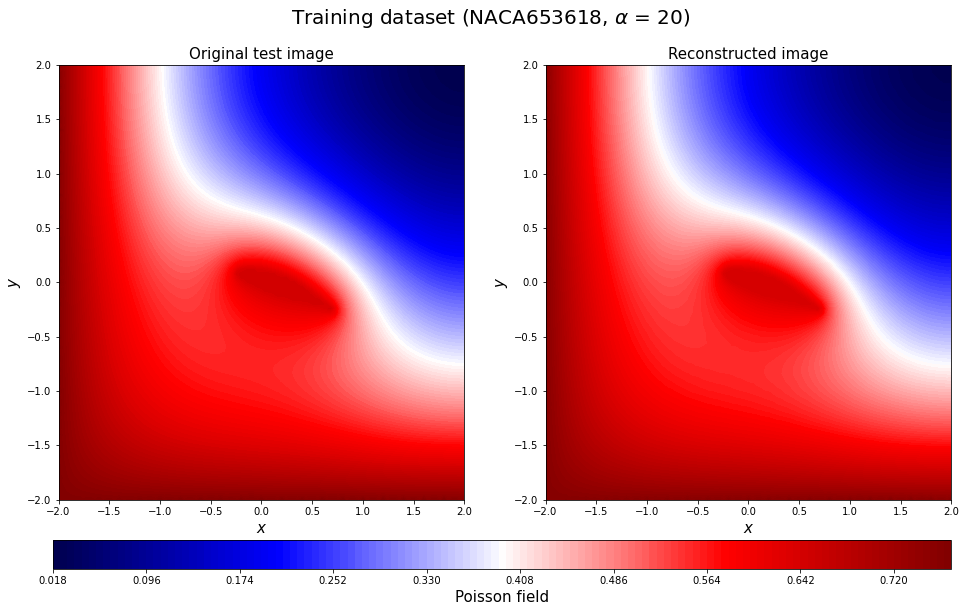

In [54]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_train0_rotate = y_train[c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_train[c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_train0_rotate,levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Training dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_train[c])[3:-2], aa_train[c]),fontsize=20)
    save_fig_name = "20221027Prediction_Poisson_bc2(training)"+str(np.array2string(geo_train[c])[3:-2])+str(aa_train[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

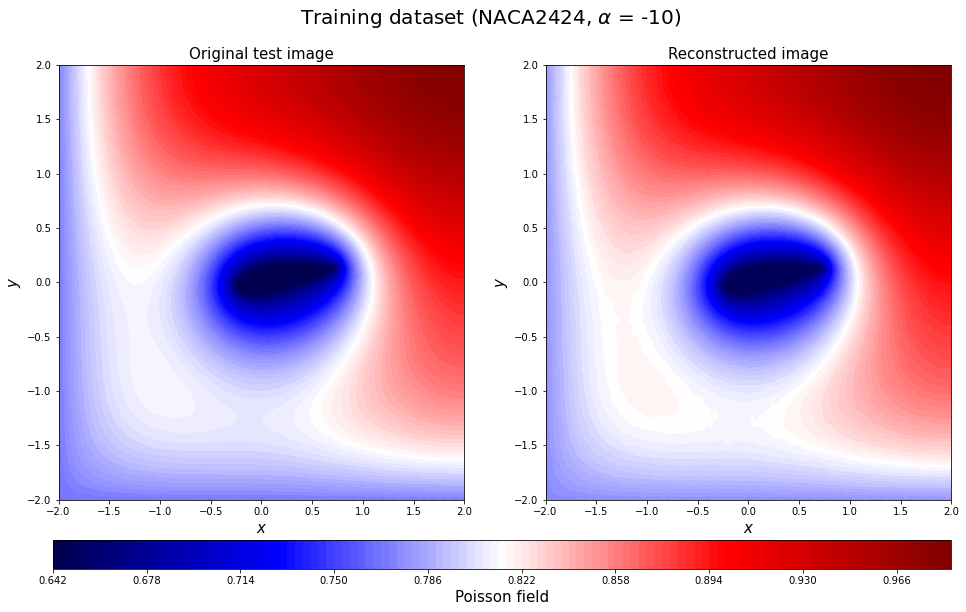

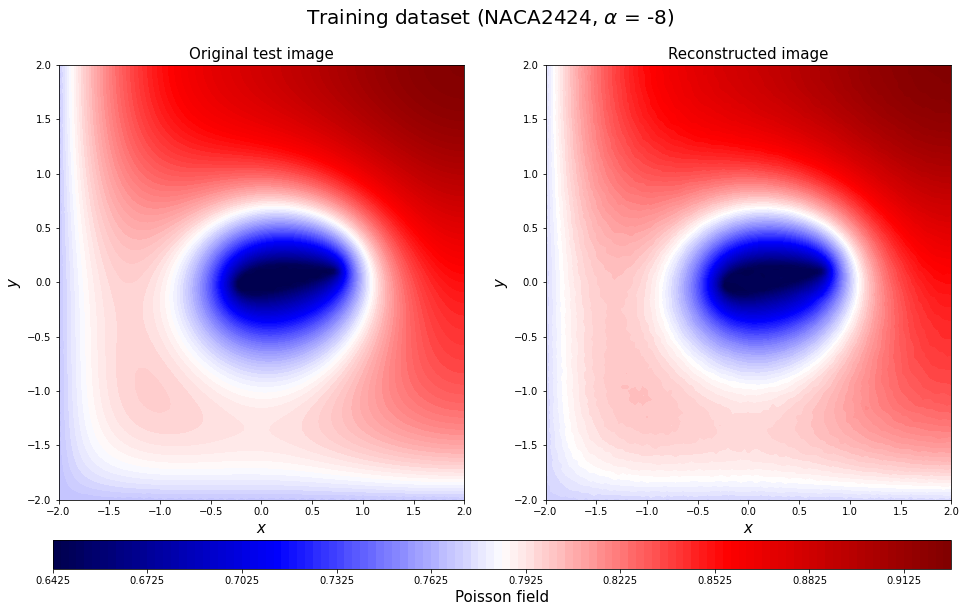

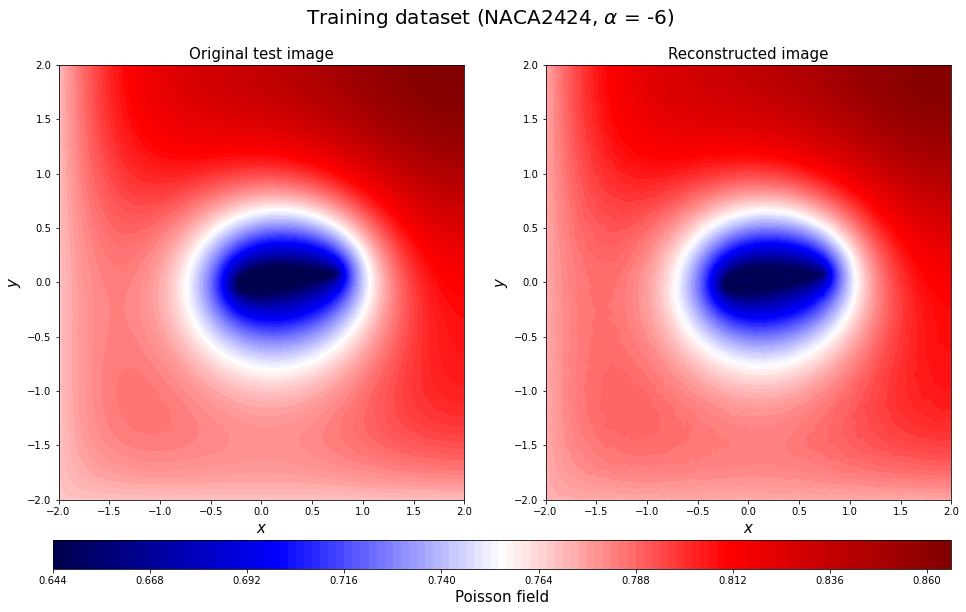

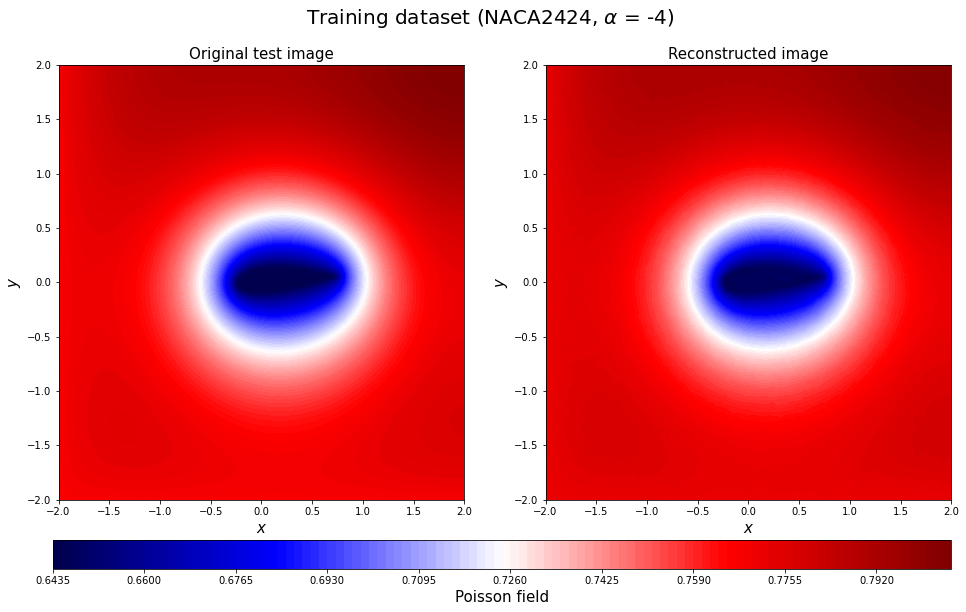

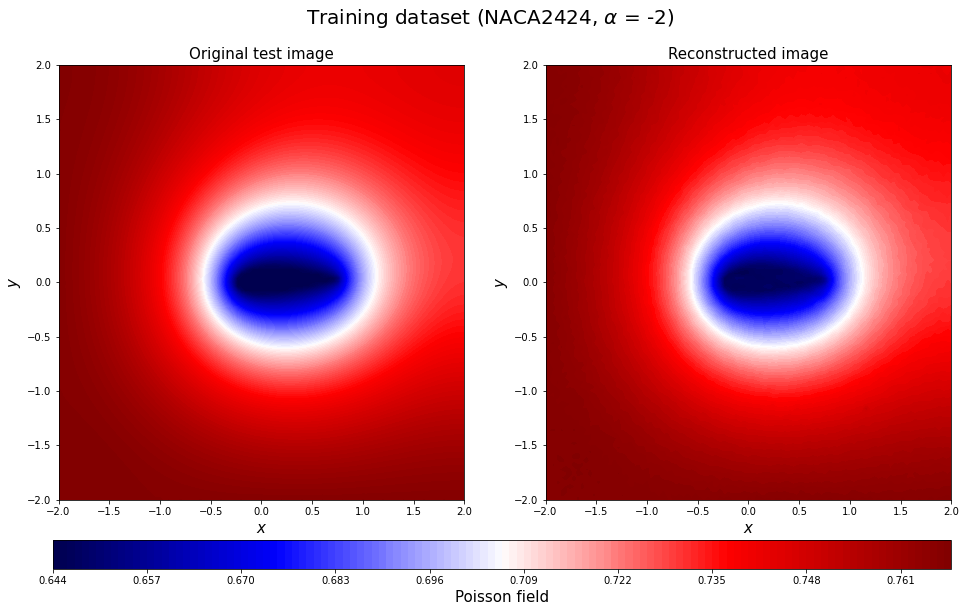

...

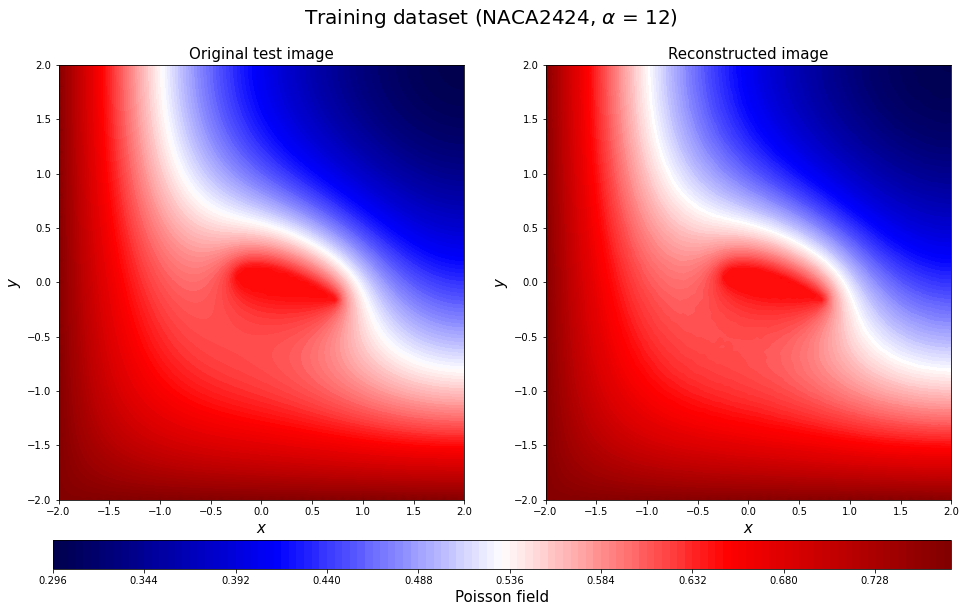

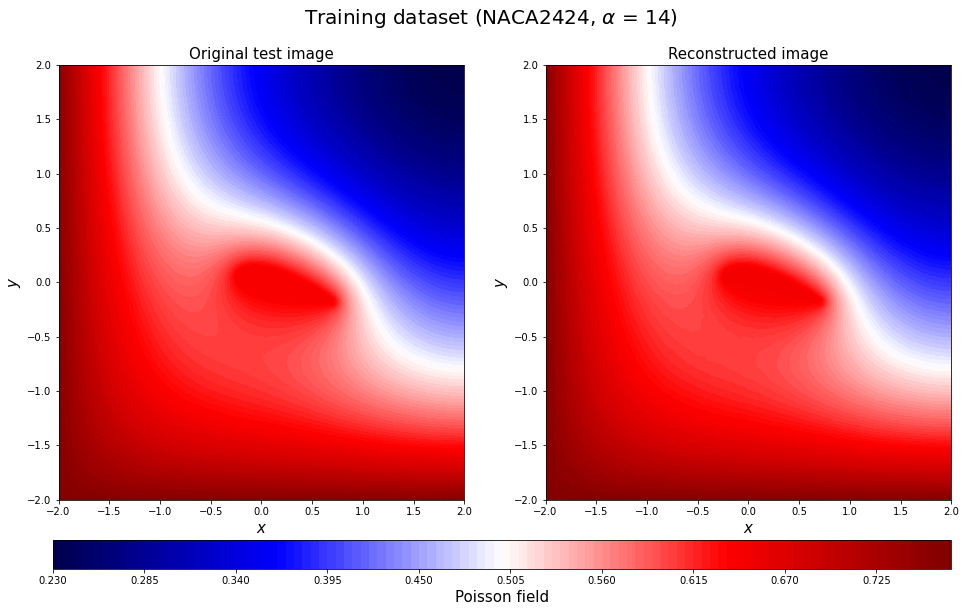

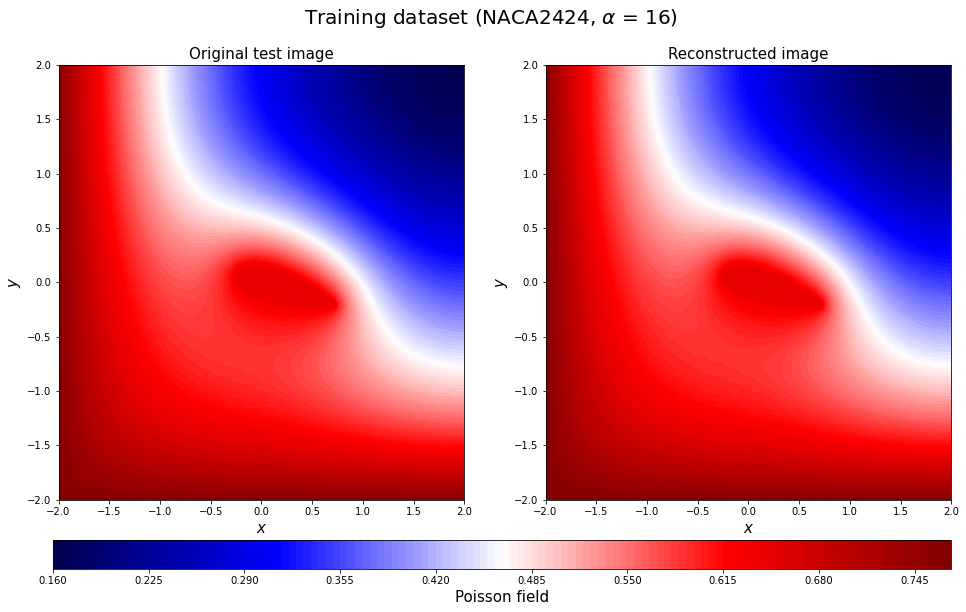

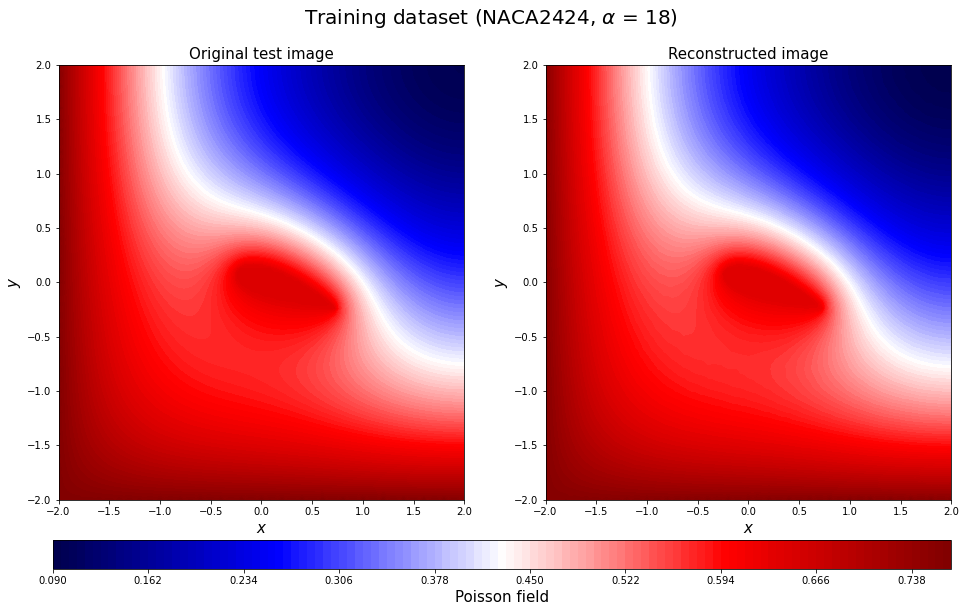

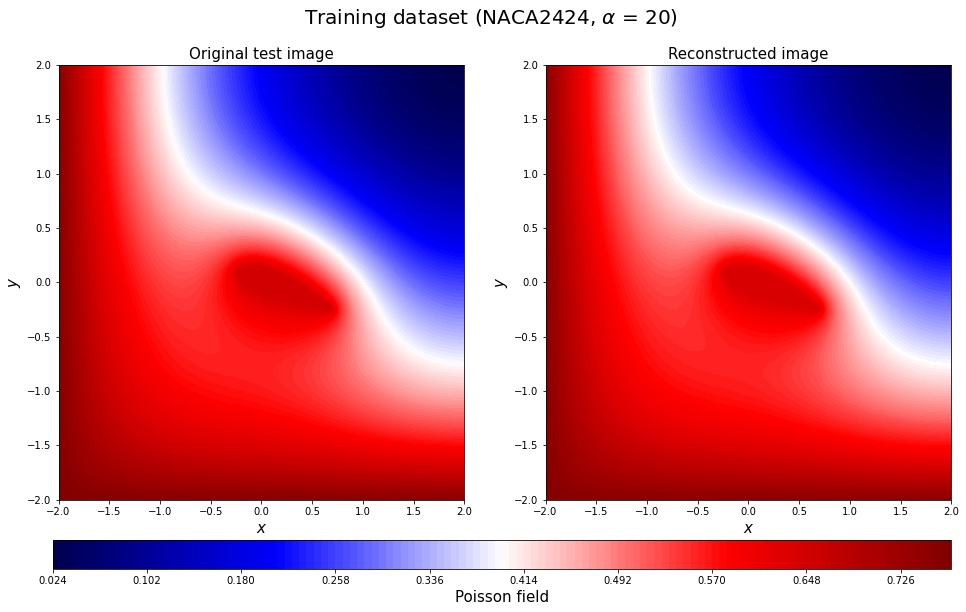

In [55]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_train20_rotate = y_train[20*16+c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_train[20*16+c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_train20_rotate, levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Training dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_train[20*16+c])[3:-2], aa_train[20*16+c]),fontsize=20)
    save_fig_name = "20221027Prediction_Poisson_bc2(training)"+str(np.array2string(geo_train[20*16+c])[3:-2])+str(aa_train[20*16+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

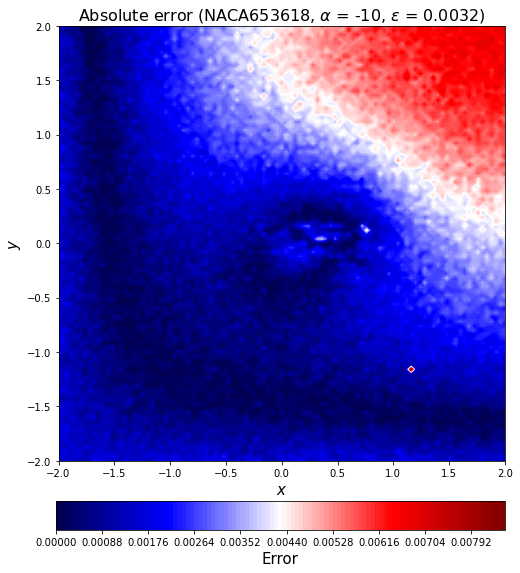

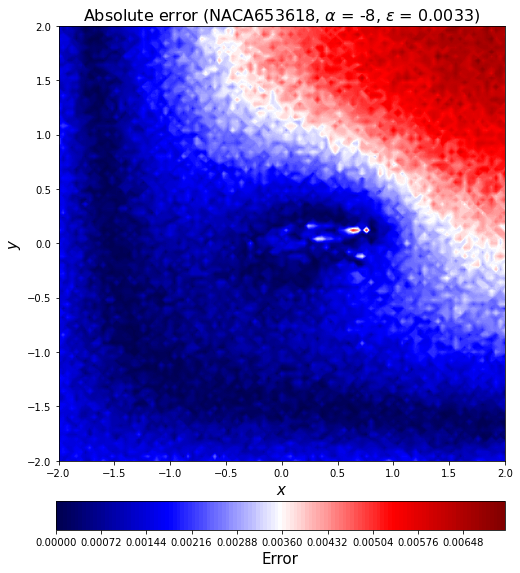

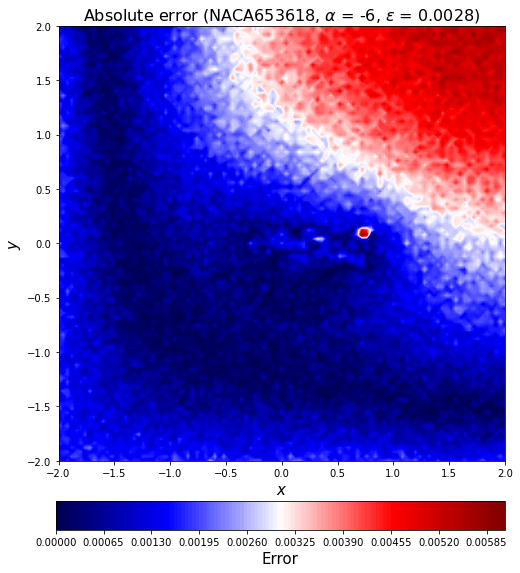

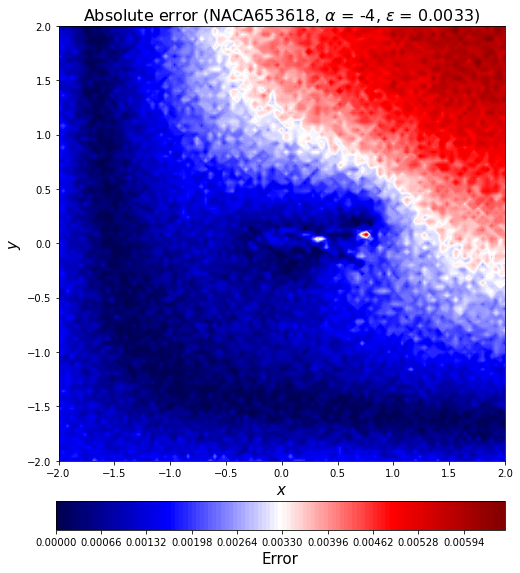

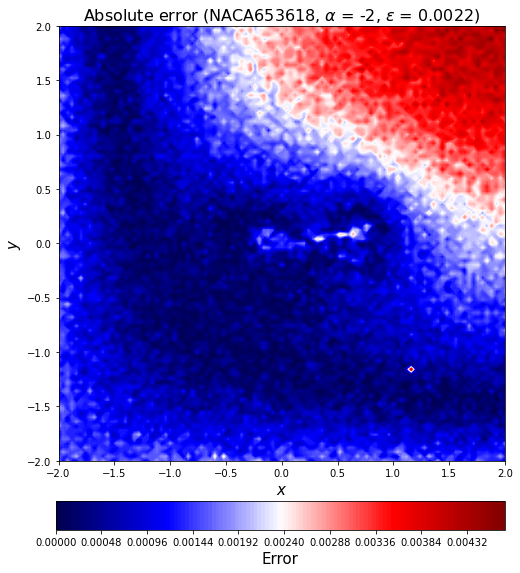

...

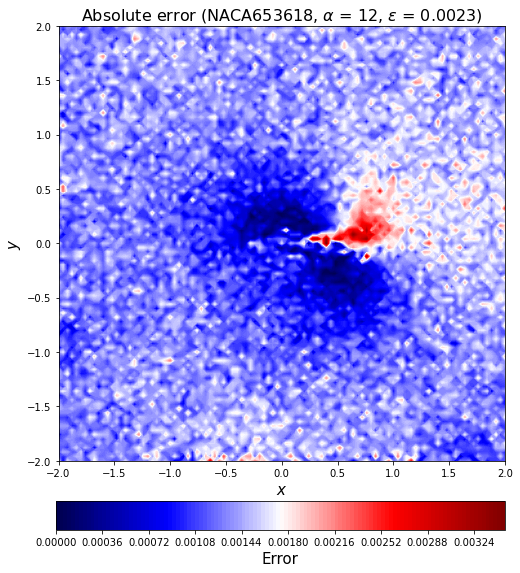

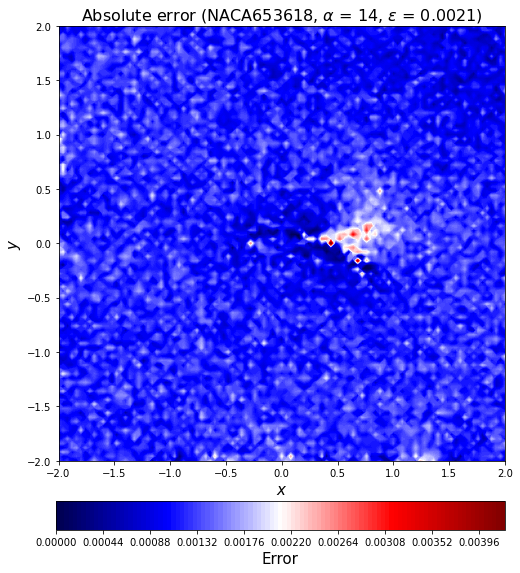

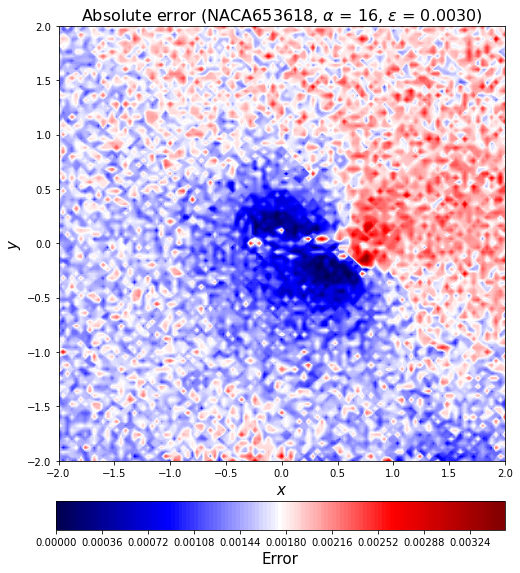

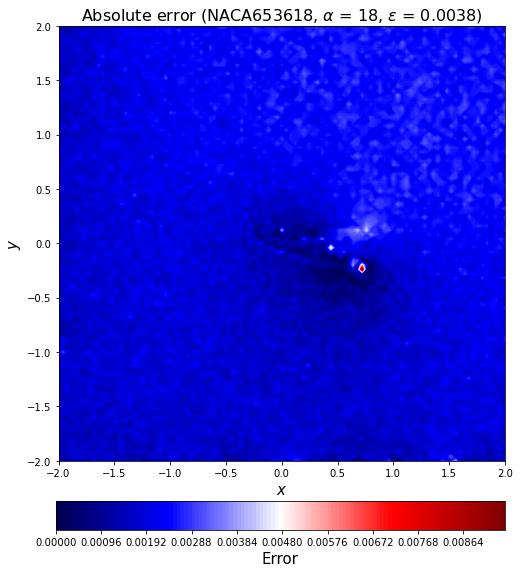

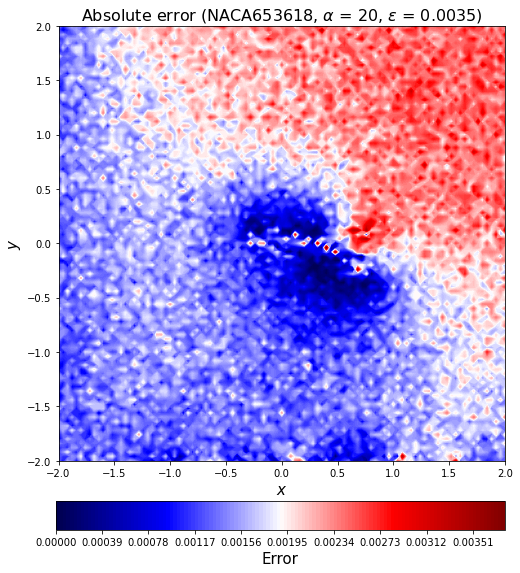

In [56]:
for c in range(0,16):
    error_train_abs2_rotate = error_train_abs[c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_train_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_train[c])[3:-2],
                                                                             aa_train[c], l2_error_train_list[c]), fontsize=16)
    ax5.set_xlabel('$x$', fontsize=15)
    ax5.set_ylabel('$y$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221027PredictionError_Poisson_bc2(training)"+str(np.array2string(geo_train[c])[3:-2])+str(aa_train[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

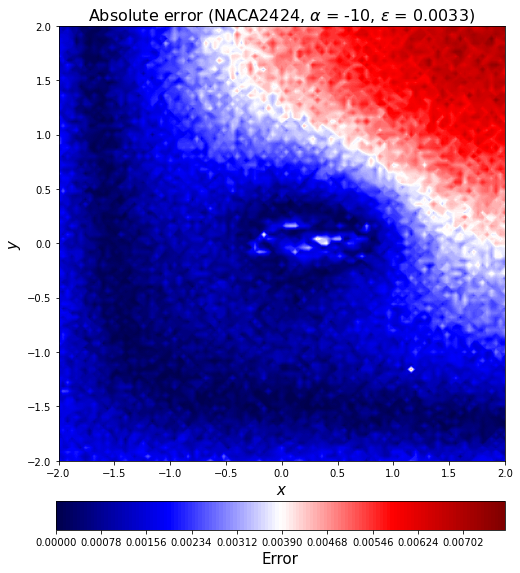

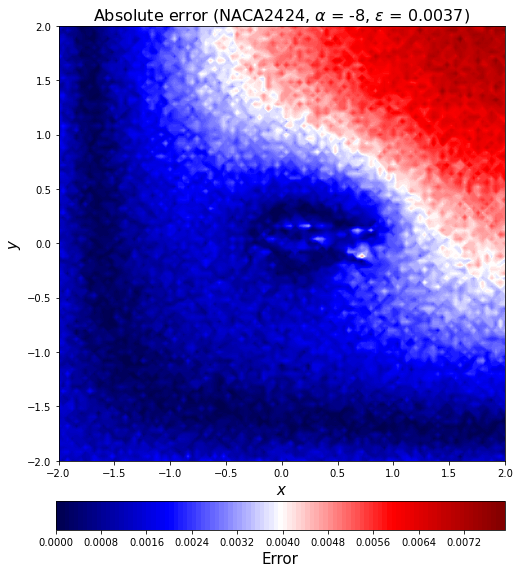

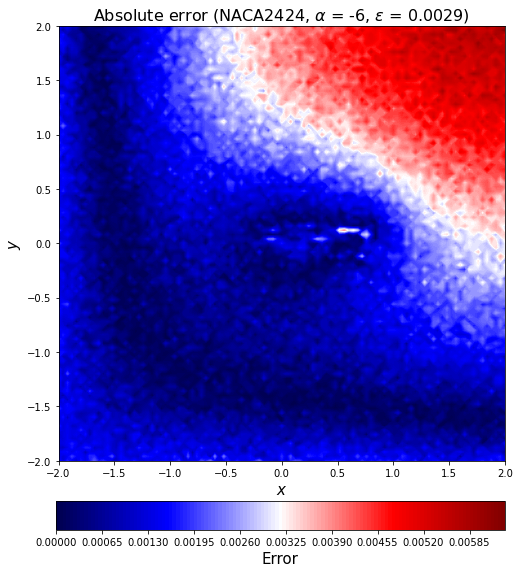

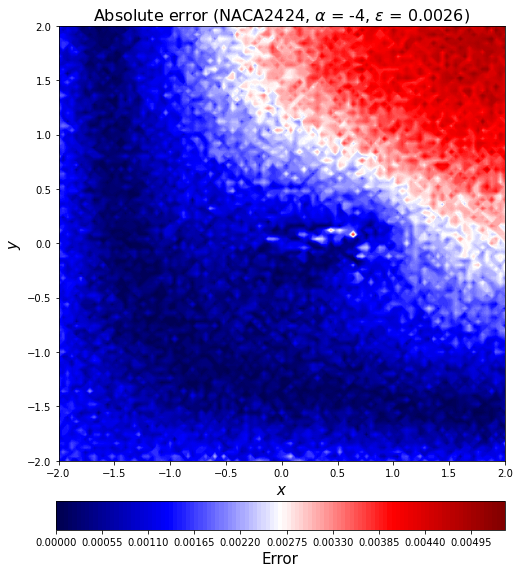

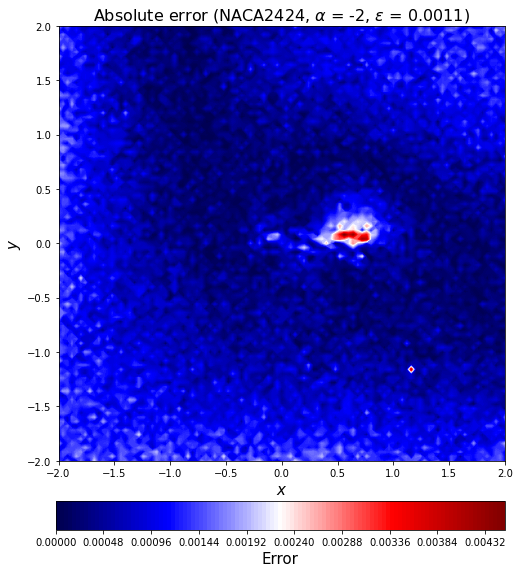

...

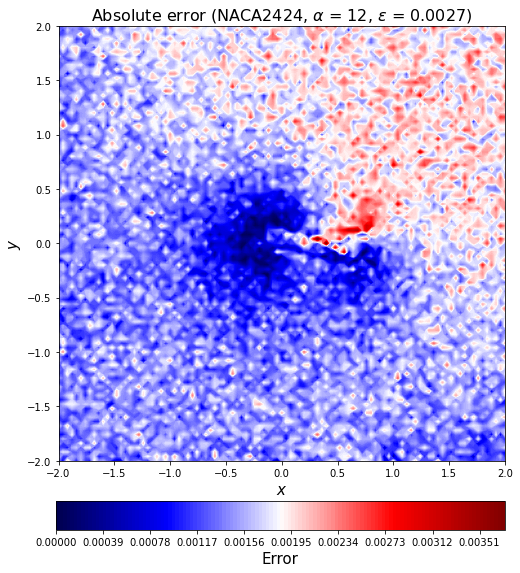

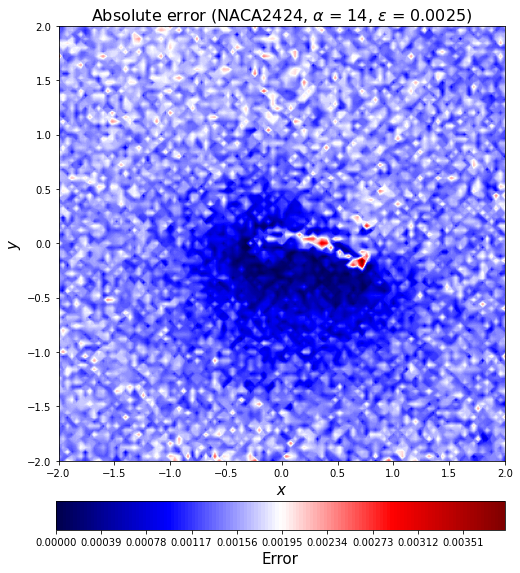

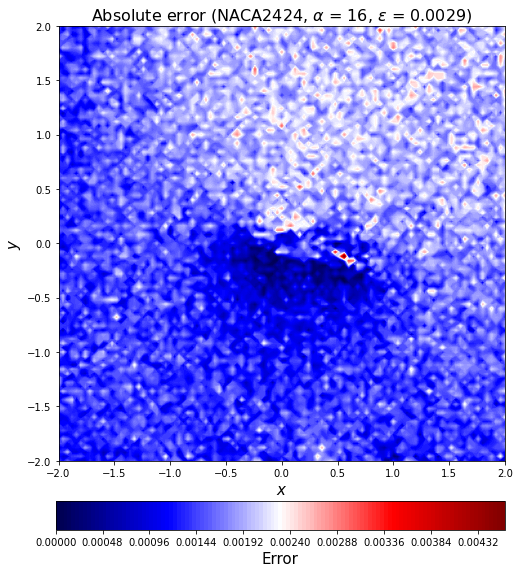

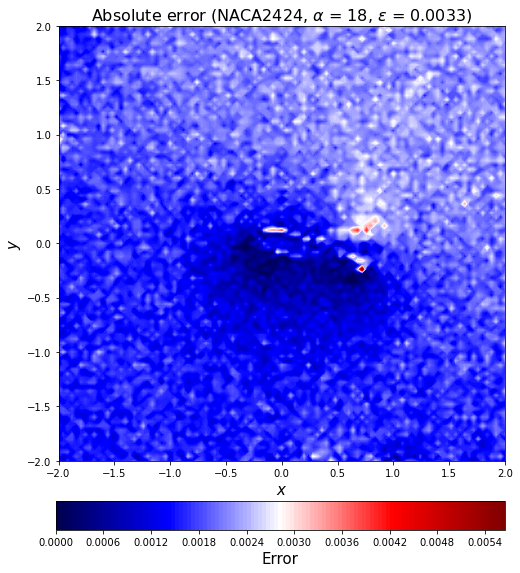

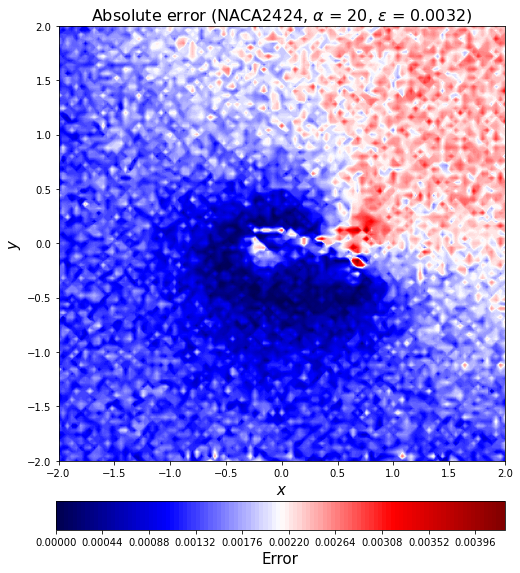

In [57]:
for c in range(0,16):
    error_train_abs2_rotate = error_train_abs[16*20+c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_train_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_train[16*20+c])[3:-2],
                                                                             aa_train[16*20+c], l2_error_train_list[16*20+c]),fontsize=16)
    ax5.set_xlabel('$x$', fontsize=15)
    ax5.set_ylabel('$y$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221027PredictionError_Poisson_bc2(training)"+str(np.array2string(geo_train[16*20+c])[3:-2])+str(aa_train[16*20+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

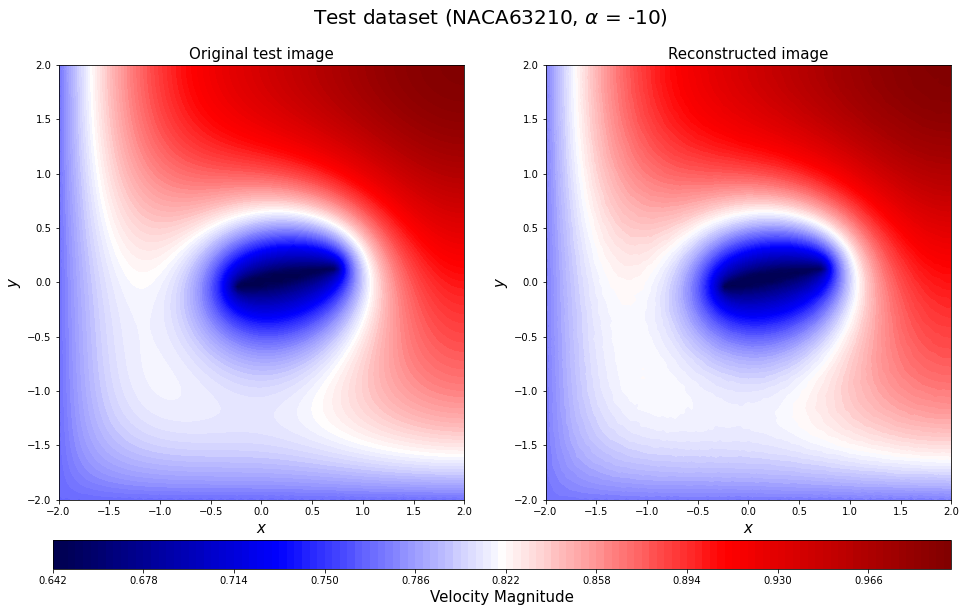

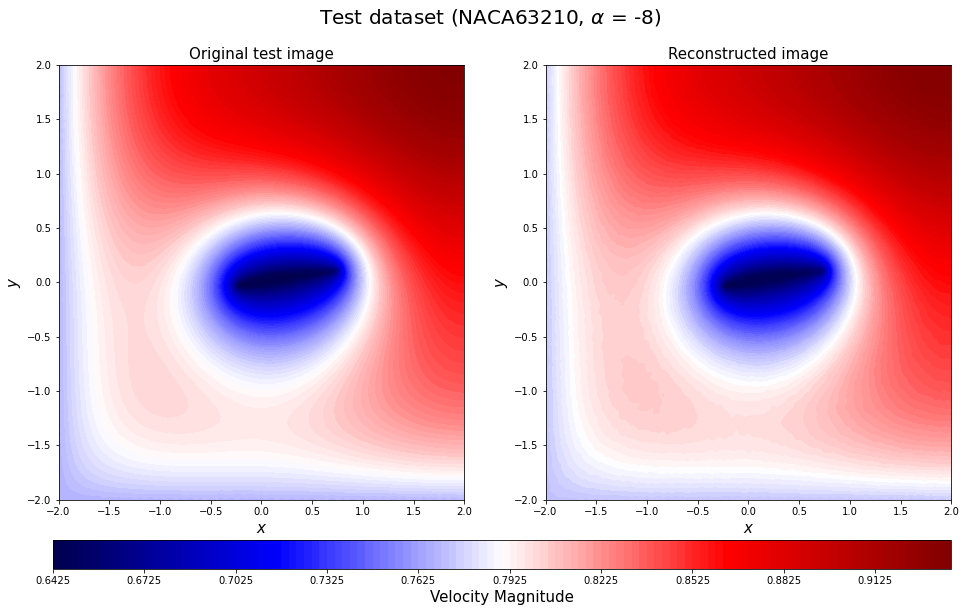

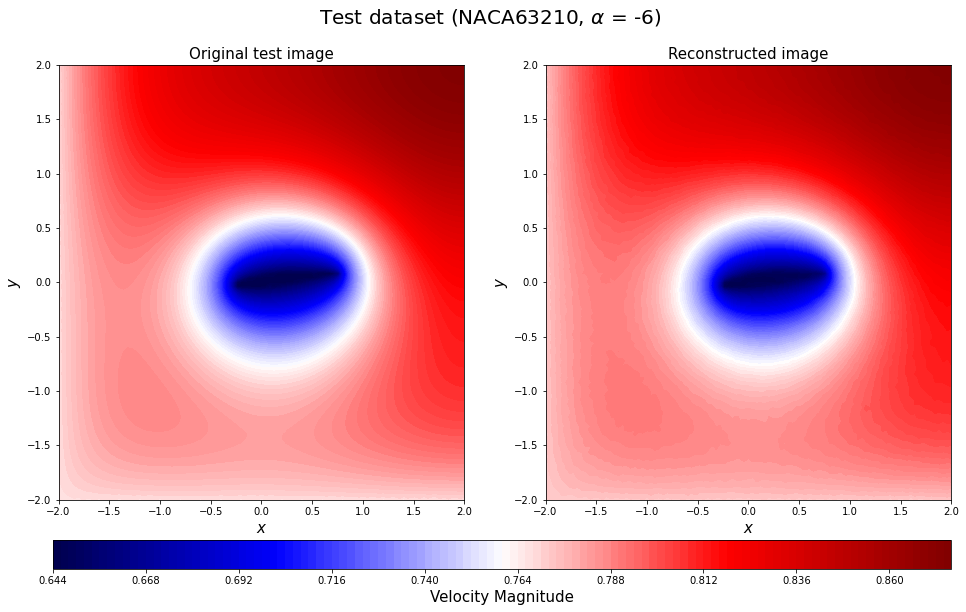

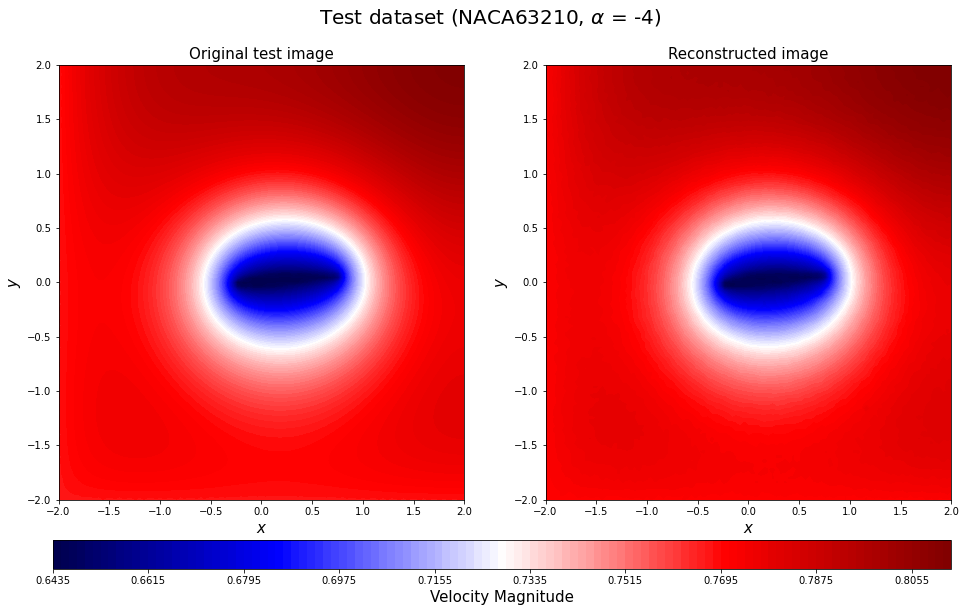

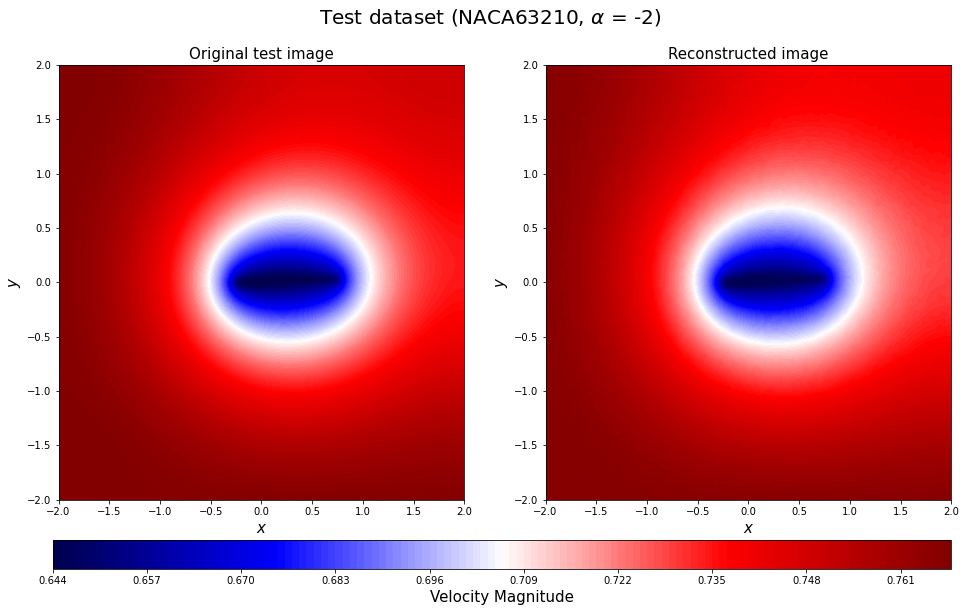

...

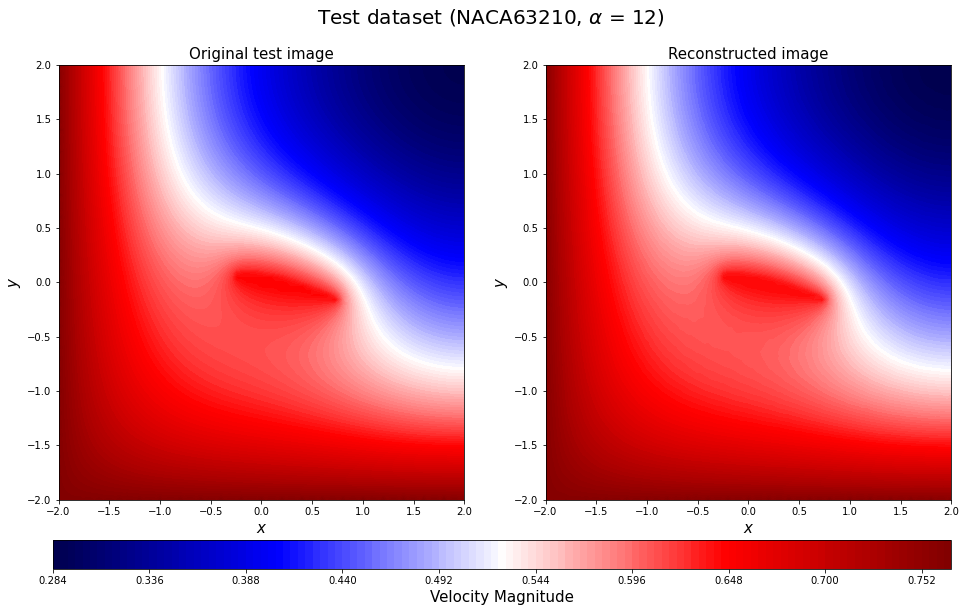

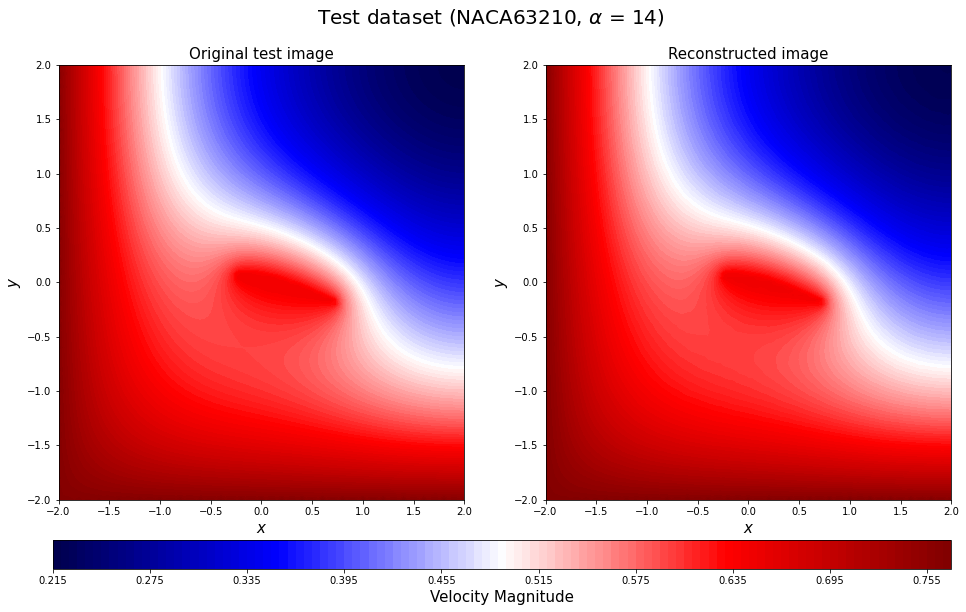

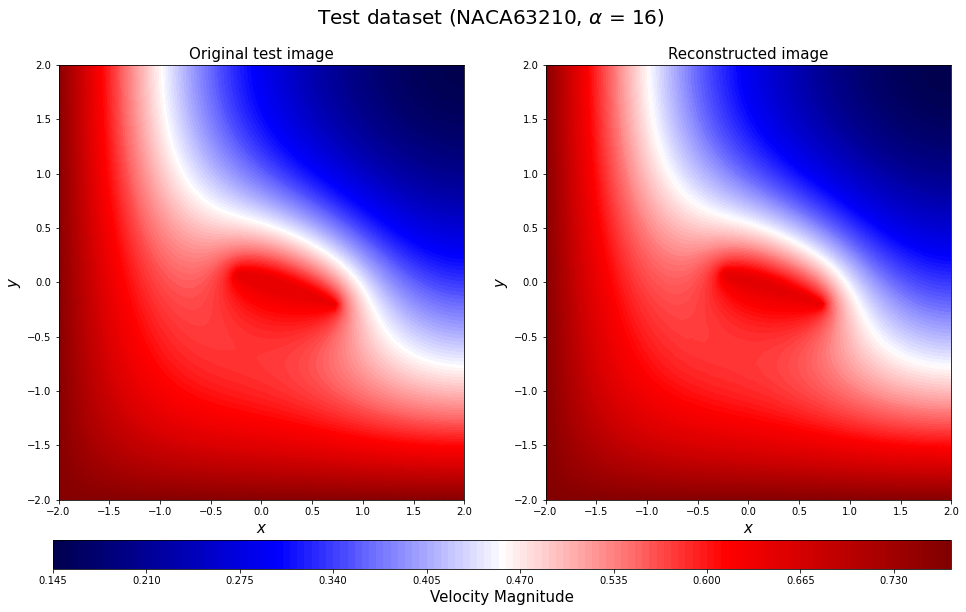

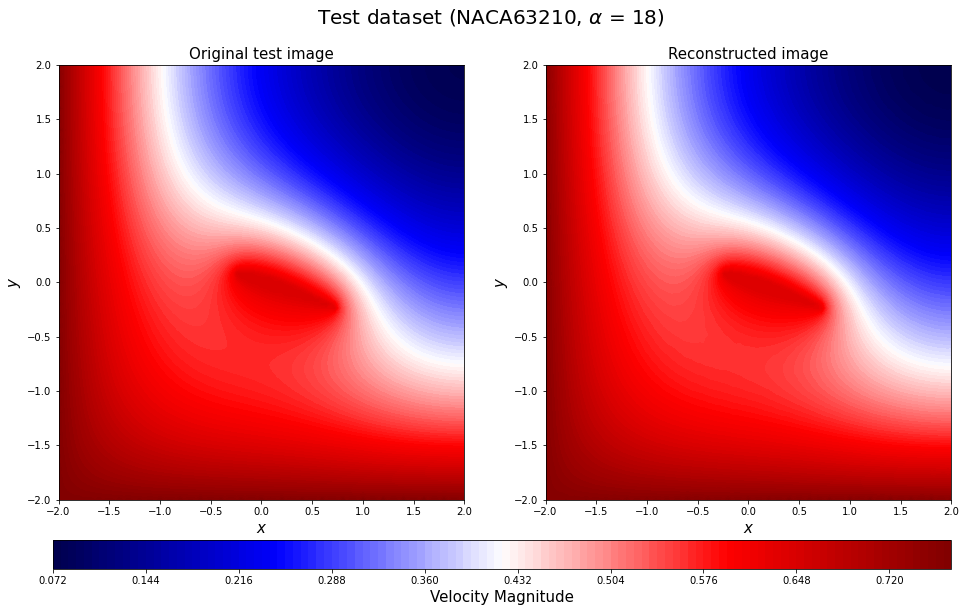

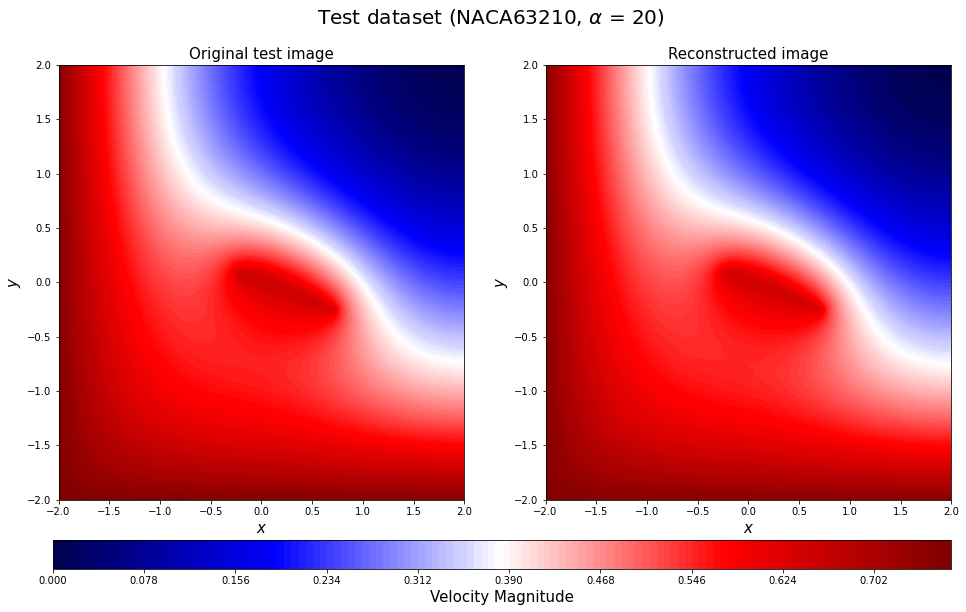

In [58]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_test2_rotate = y_test[2*16+c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_test[2*16+c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_test2_rotate, levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Velocity Magnitude', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[2*16+c])[3:-2], aa_test[2*16+c]),fontsize=20)
    save_fig_name = "20221027Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[2*16+c])[3:-2])+str(aa_test[2*16+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

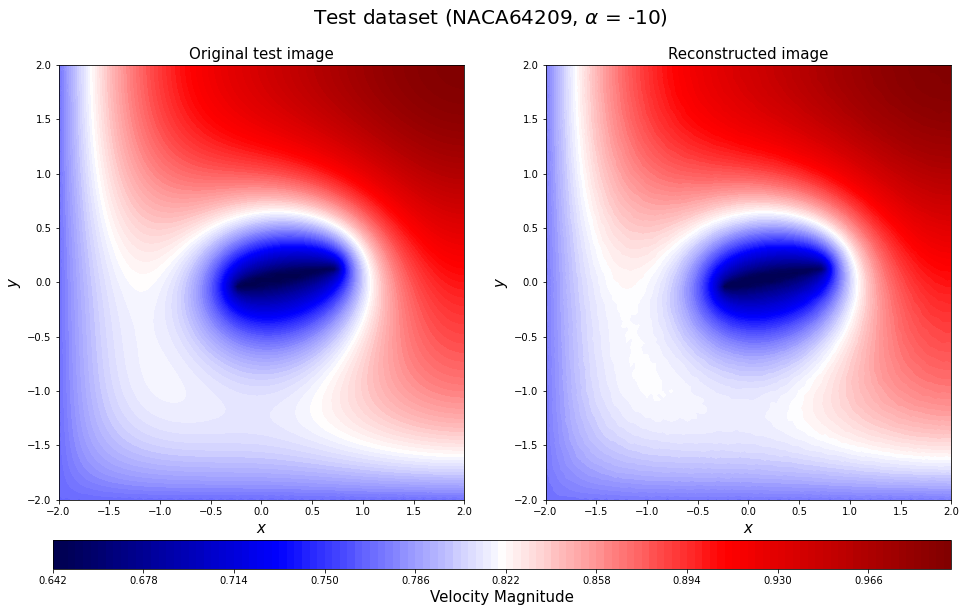

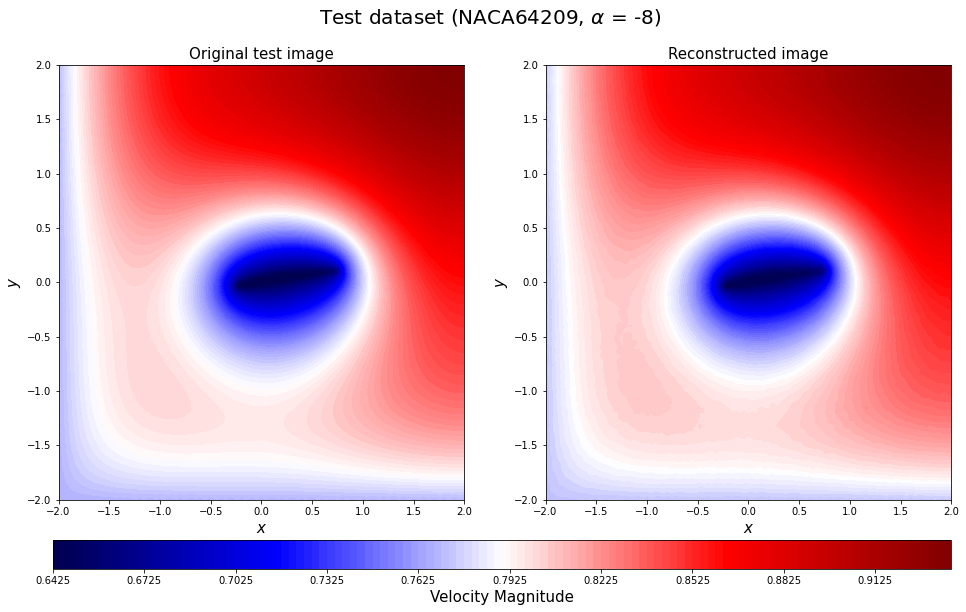

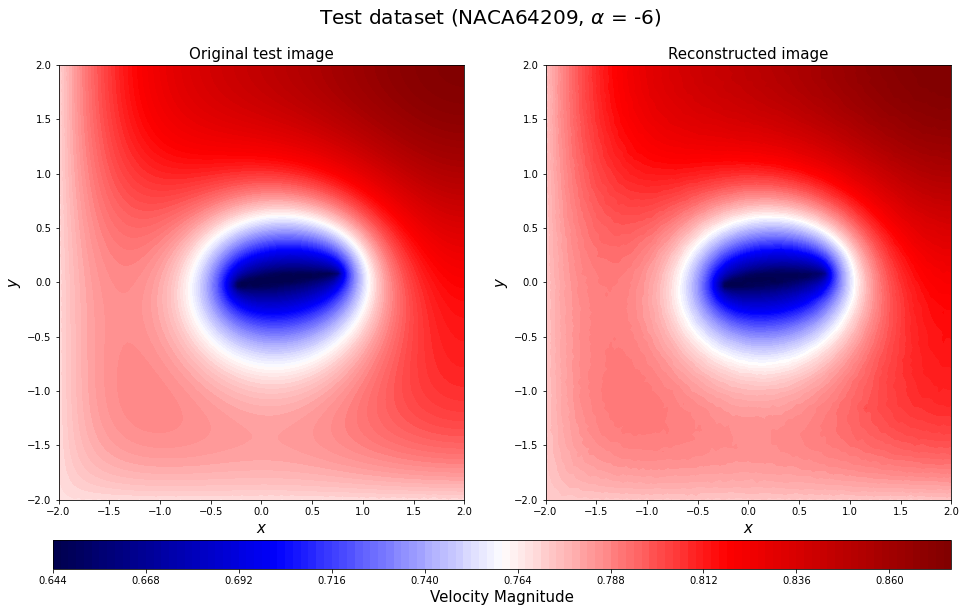

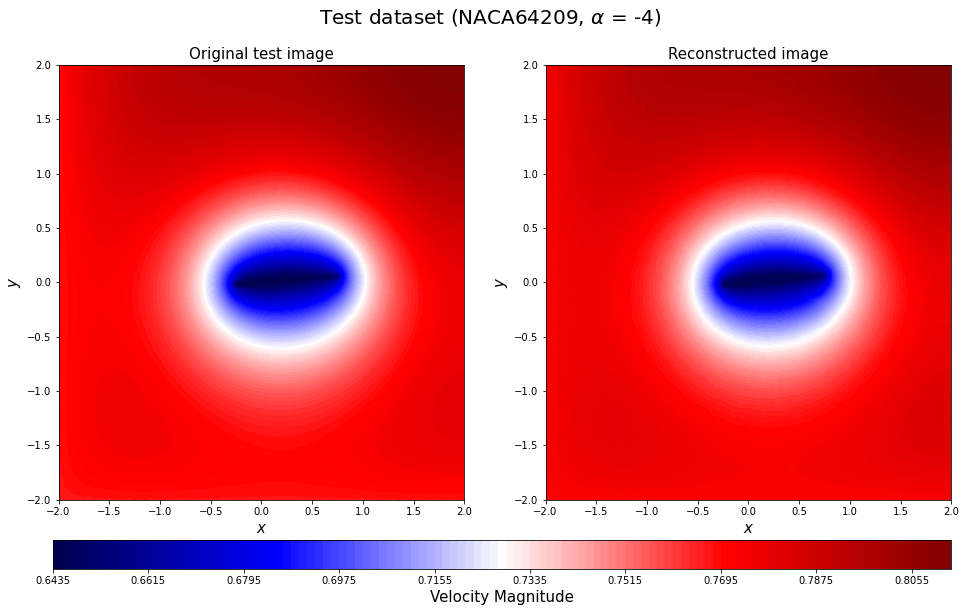

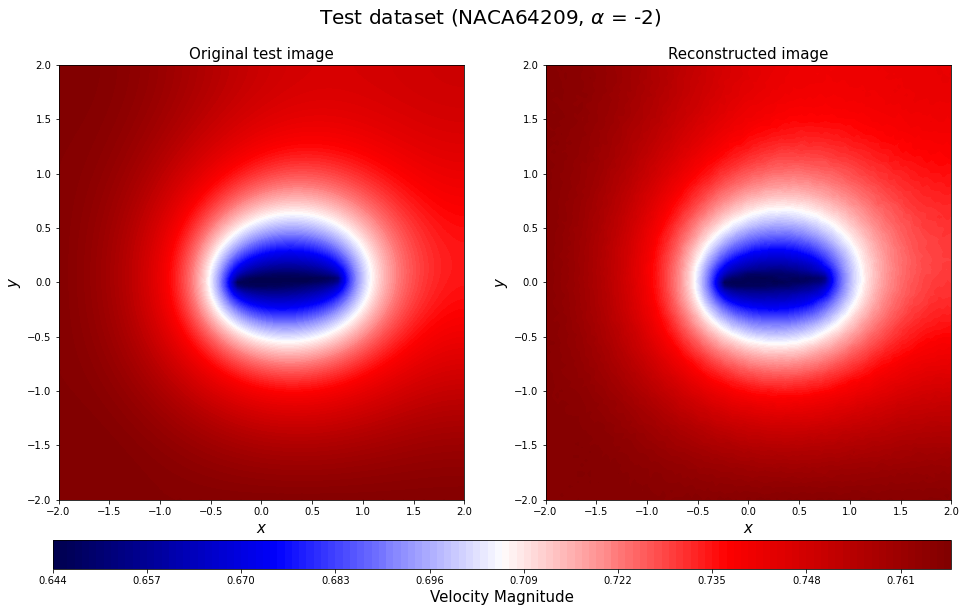

...

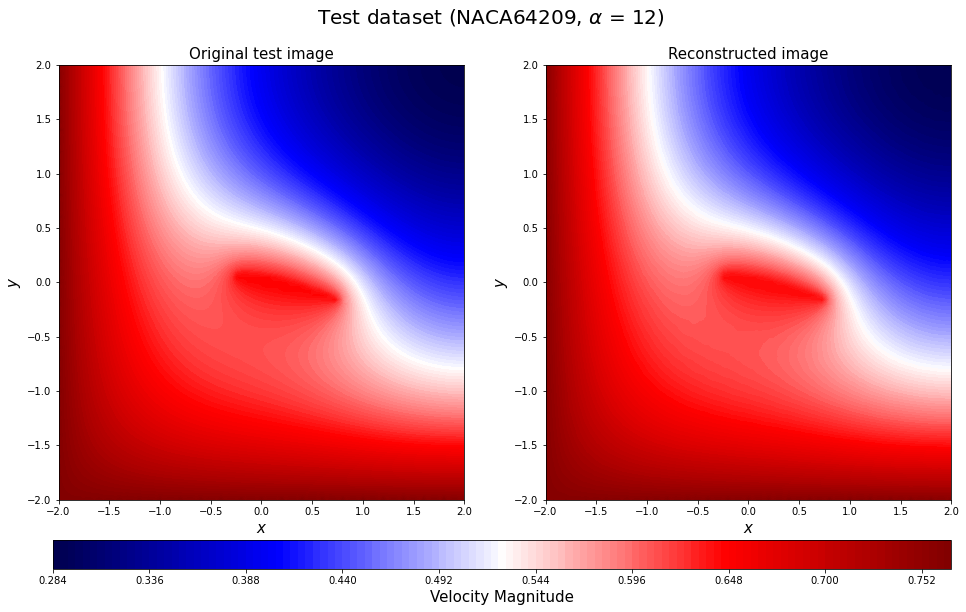

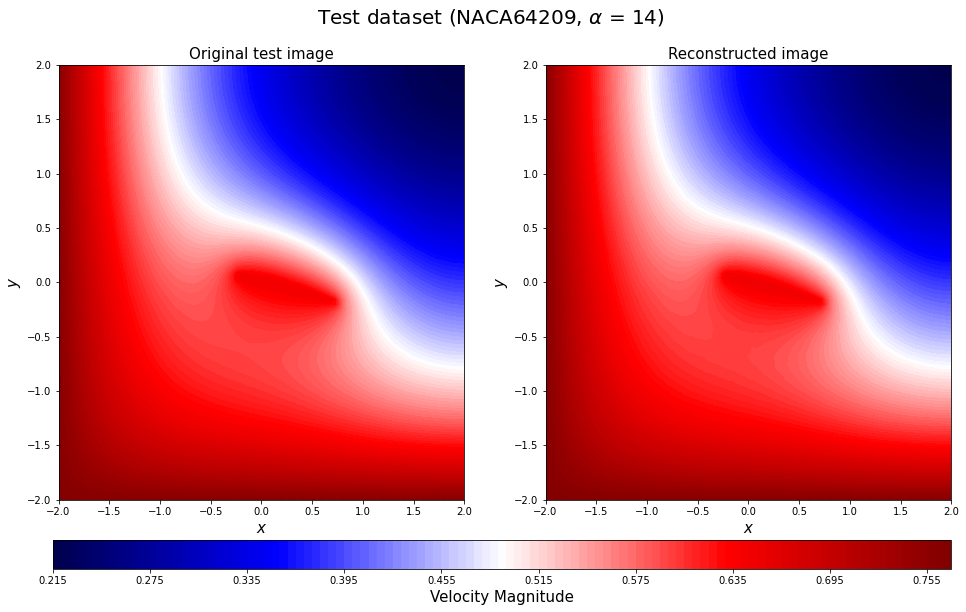

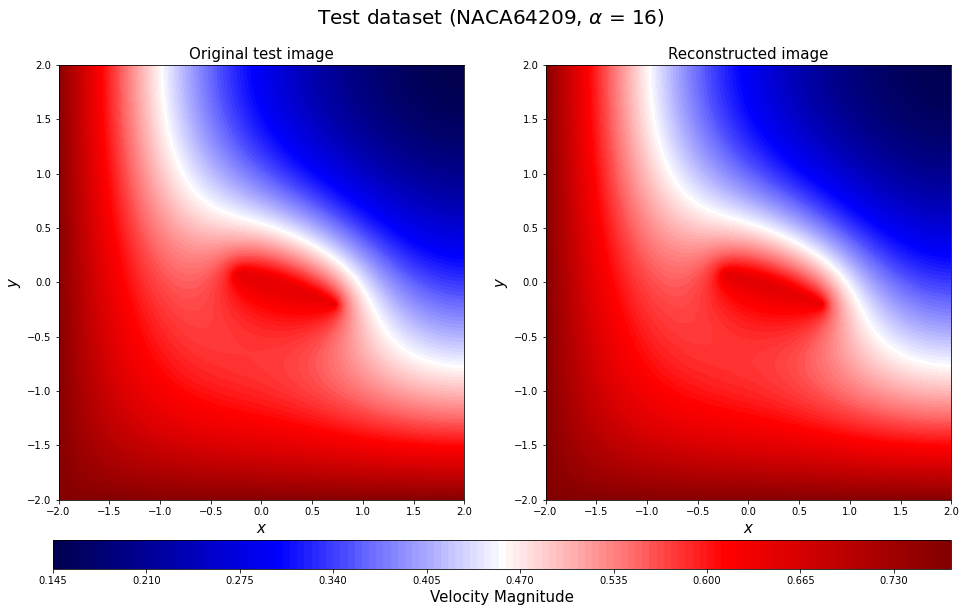

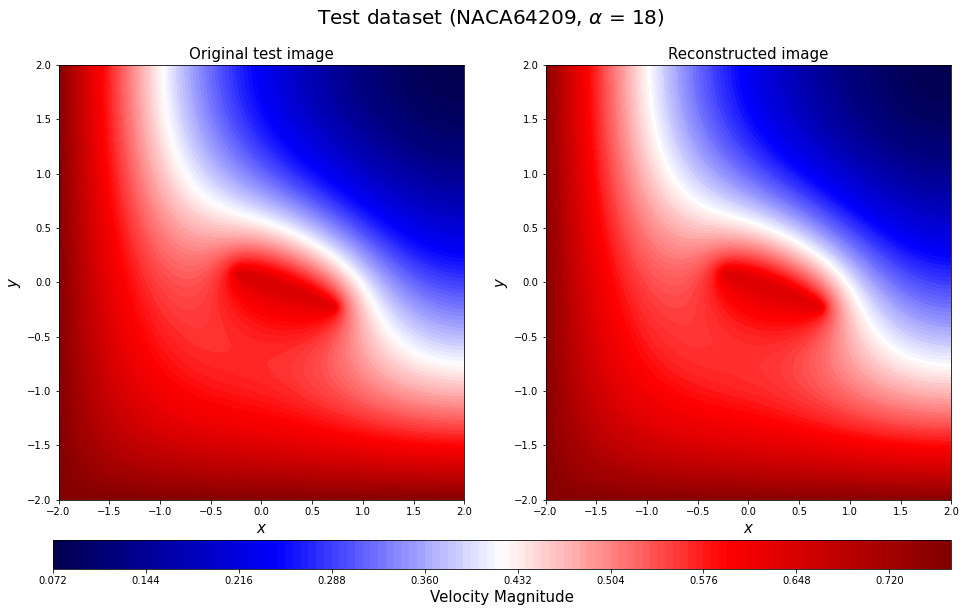

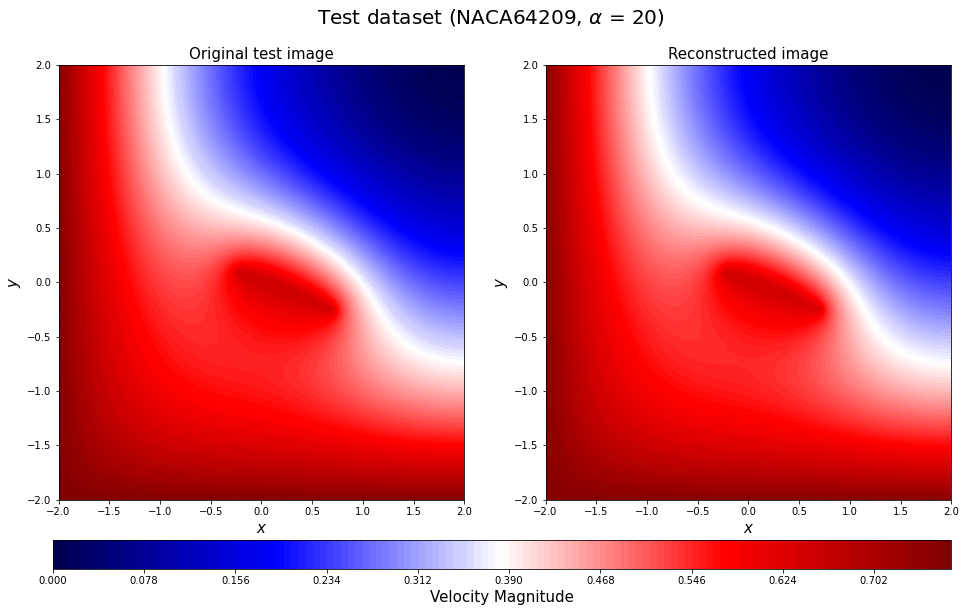

In [59]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Velocity Magnitude', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
    save_fig_name = "20221027Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

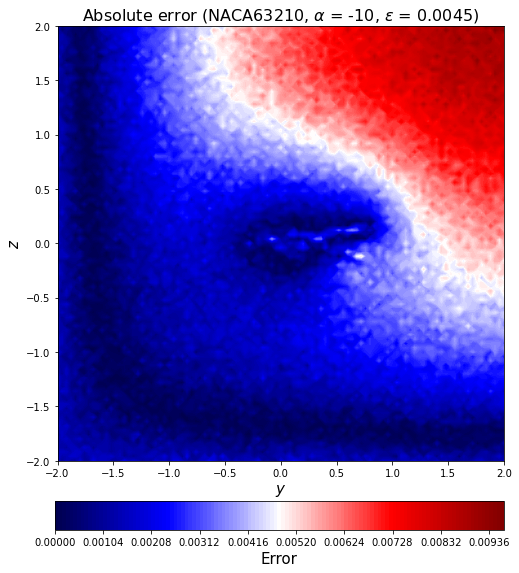

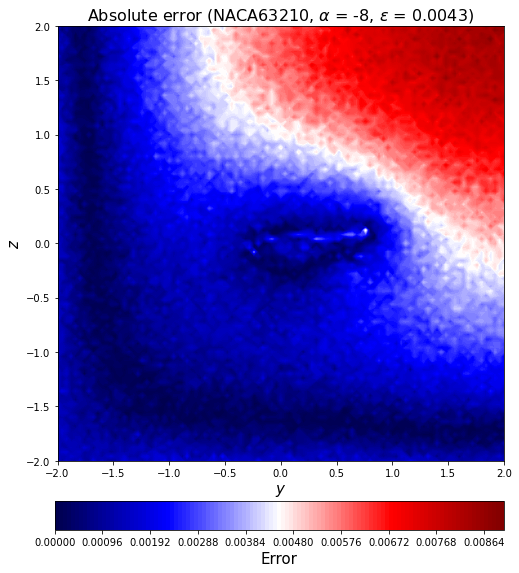

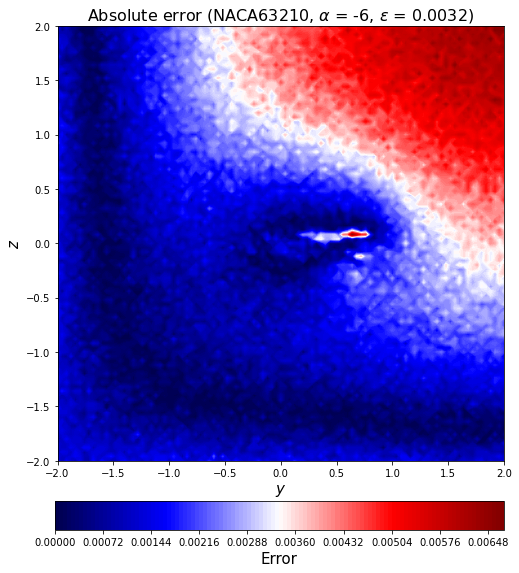

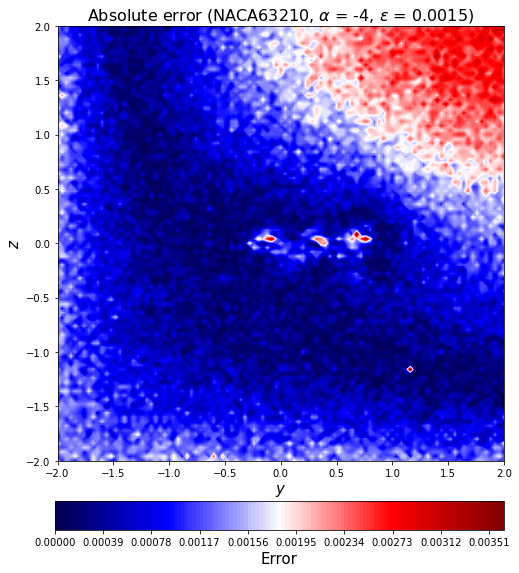

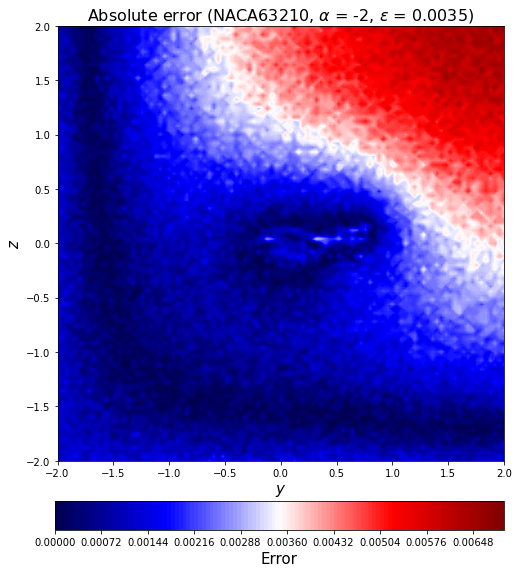

...

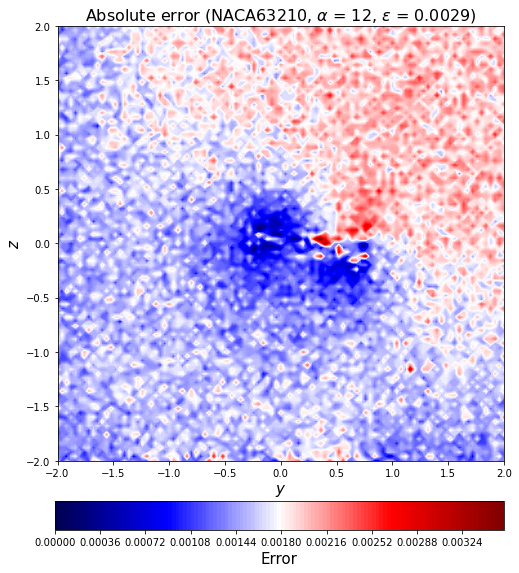

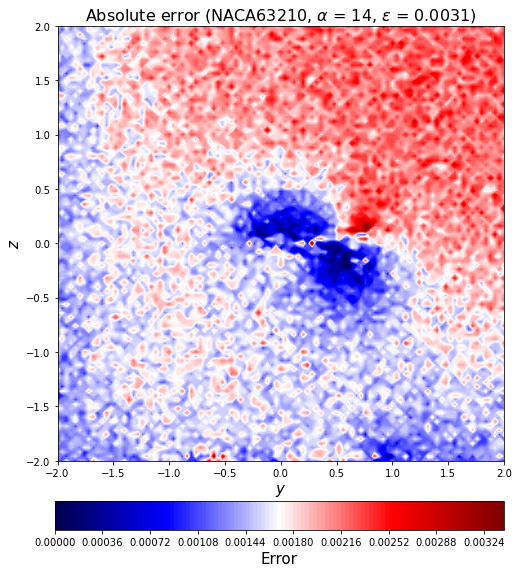

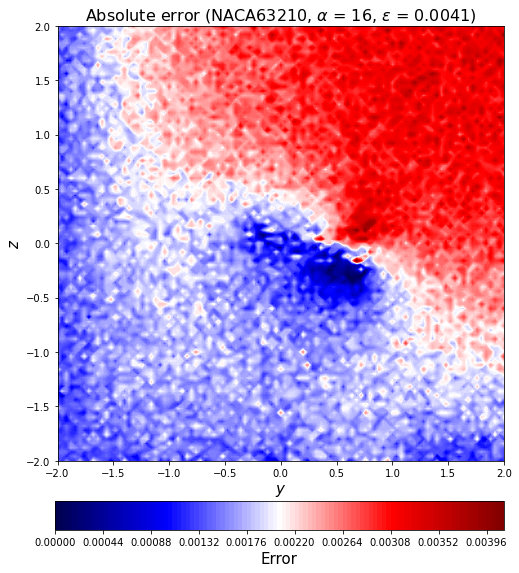

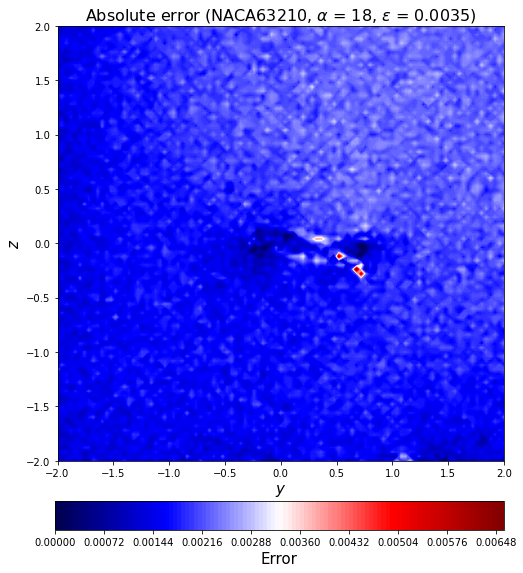

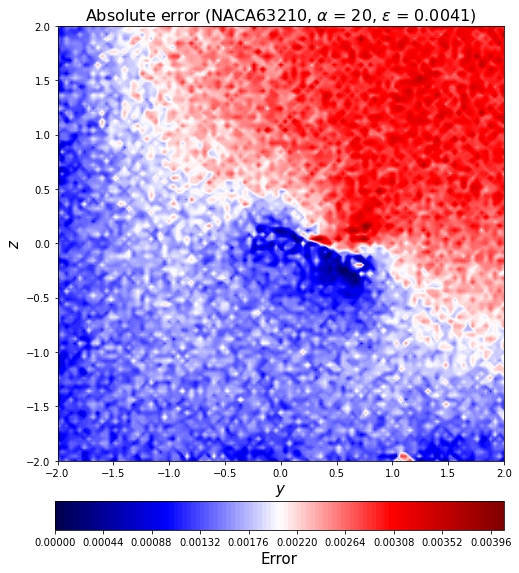

In [60]:
for c in range(0,16):
    error_test_abs2_rotate = error_test_abs[2*16+c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[2*16+c])[3:-2],
                                                                       aa_test[2*16+c], l2_error_test_list[2*16+c]), fontsize=16)
    ax5.set_xlabel('$y$', fontsize=15)
    ax5.set_ylabel('$z$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221027PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[2*16+c])[3:-2])+str(aa_test[2*16+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

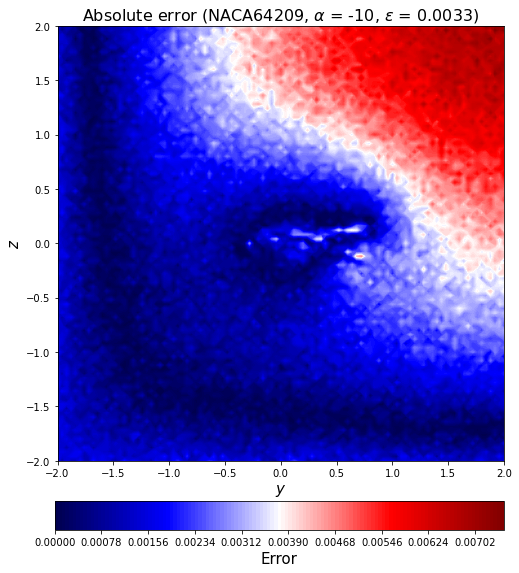

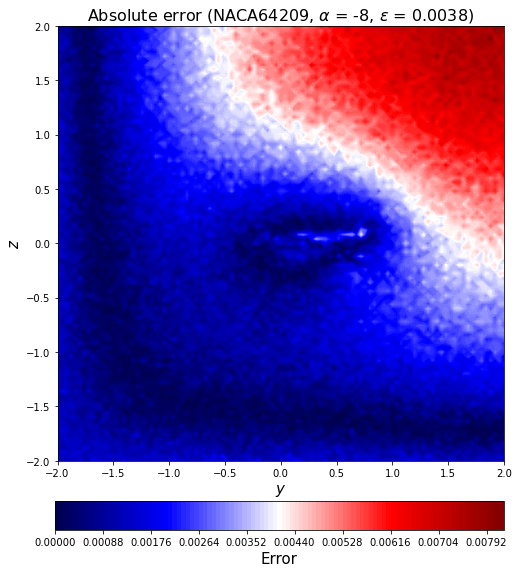

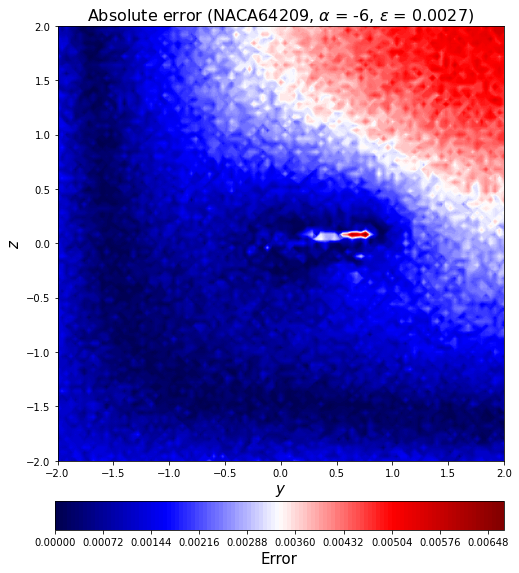

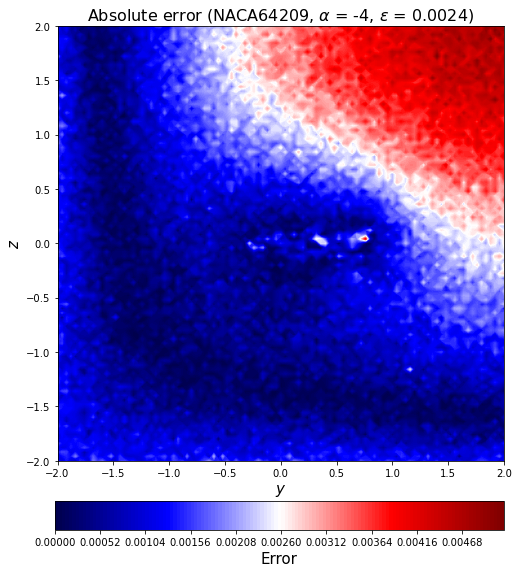

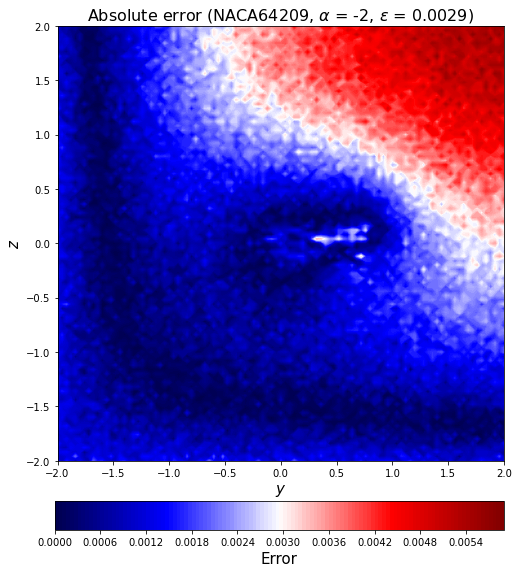

...

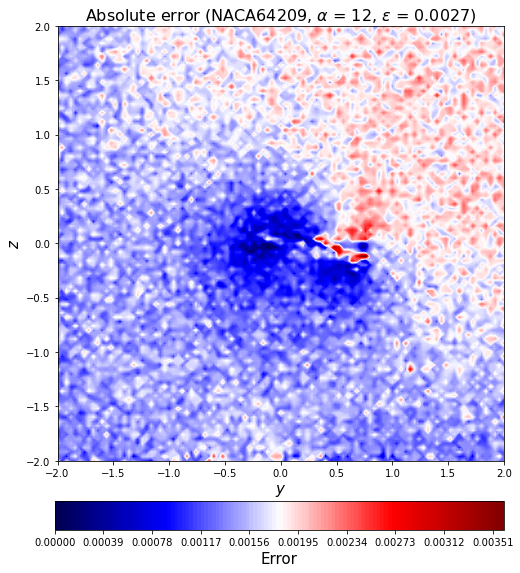

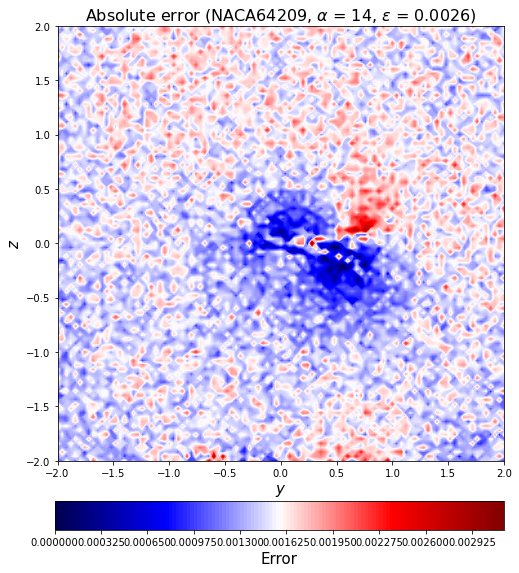

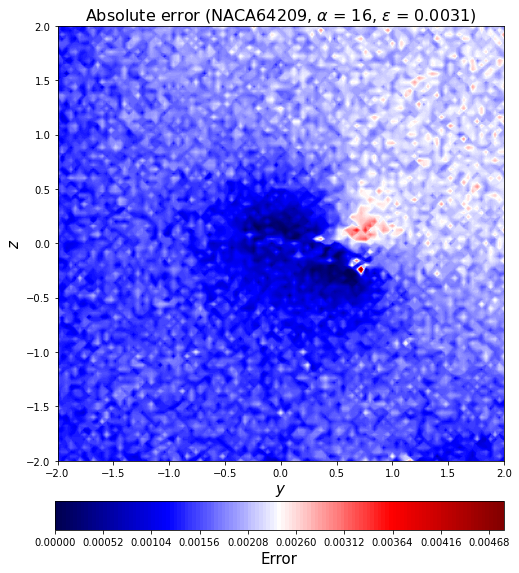

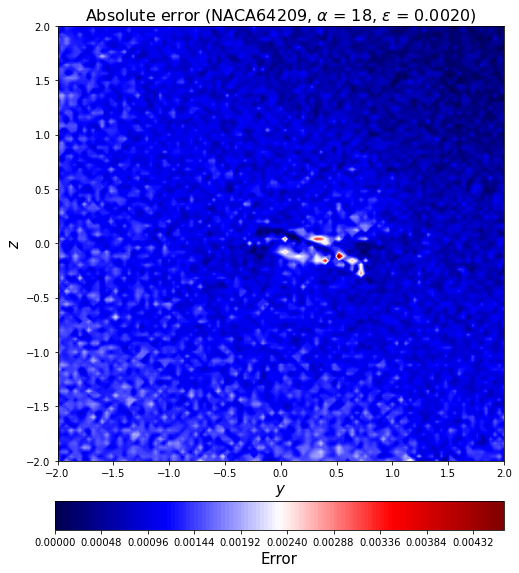

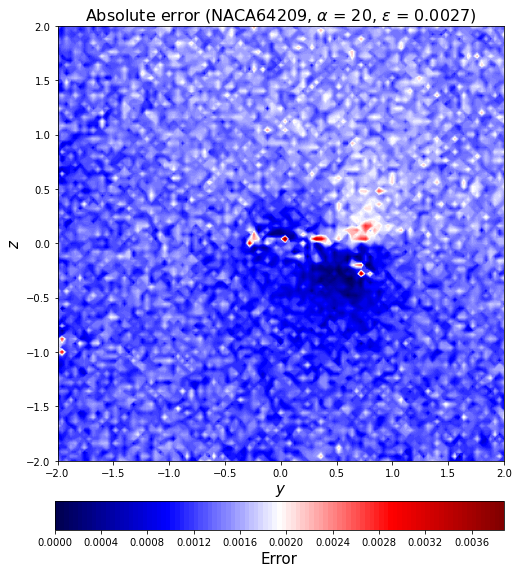

In [61]:
for c in range(0,16):
    error_test_abs2_rotate = error_test_abs[c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[c])[3:-2],
                                                                       aa_test[c], l2_error_test_list[c]), fontsize=16)
    ax5.set_xlabel('$y$', fontsize=15)
    ax5.set_ylabel('$z$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221027PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

In [62]:
MAPE_train = (np.sum(np.abs(np.sum(y_train)-np.sum(decoded_train))) / np.abs(np.sum(y_train)))/(y_train.shape[0]/11)*100
acc_train = 1-MAPE_train

In [63]:
MAPE_test = (np.sum(np.abs(np.sum(y_test)-np.sum(decoded_test))) / np.abs(np.sum(y_test)))/(y_test.shape[0]/11)*100
acc_test = 1-MAPE_test

In [64]:
print(MAPE_train)
print(acc_train)

0.00015582508321287182
0.9998441749167871


In [65]:
print(MAPE_test)
print(acc_test)

0.0033807784288574336
0.9966192215711426


In [66]:
MAPE_train_list = []
acc_train_list = []
for i in range(0, len(aa_train)):
    MAPE_train_data = (np.sum(np.abs(y_train[i]-decoded_train[i])) / np.sum(np.abs(y_train[i])))/(y_train.shape[0]/11)*100
    MAPE_train_list.append(MAPE_train_data)
    acc_train_data = 1 - MAPE_train_data
    acc_train_list.append(acc_train_data)
print(MAPE_train_list)
print(acc_train_list)

[0.0017765891207863946, 0.0017947511911333357, 0.0015371428580119157, 0.001836205201161965, 0.0012350206833543508, 0.0015095779544081465, 0.0008925379120610253, 0.0007992446781046985, 0.0007386436965617212, 0.0007196238422871171, 0.0013690642562650484, 0.0016772314294640665, 0.0015507209443677546, 0.002271923957606689, 0.0028815814463785906, 0.0026538368471526034, 0.0017160291393178554, 0.0015381351868818597, 0.001112480122161437, 0.0008829364118021939, 0.0011029701211380904, 0.0009712360861186791, 0.0007077890577988699, 0.0007087325176124237, 0.0005944068054009224, 0.0010540108137232513, 0.0016751957827384582, 0.0020663876241272033, 0.0013290125878465072, 0.002048122191170572, 0.002198472681974405, 0.0029777915095876213, 0.0020312535670225364, 0.0021874241776049875, 0.0018759560486021904, 0.0019155682936654488, 0.0016538098017537543, 0.0013771126786853794, 0.0009002285564379764, 0.000886195637341093, 0.0006476459154378919, 0.0014001591462886951, 0.0018106434423281676, 0.00219107977410

In [67]:
MAPE_test_list = []
acc_test_list = []
for i in range(0, len(aa_test)):
    MAPE_test_data = (np.sum(np.abs(y_test[i]-decoded_test[i])) / np.sum(np.abs(y_test[i])))/(y_test.shape[0]/11)*100
    MAPE_test_list.append(MAPE_test_data)
    acc_test_data = 1 - MAPE_test_data
    acc_test_list.append(acc_test_data)
print(MAPE_test_list)
print(acc_test_list)

[0.004277099314872814, 0.004884558395017431, 0.003463430772044372, 0.0031405063859793383, 0.003682851388596651, 0.003084853127446057, 0.0017351978939472372, 0.0017119925973859242, 0.0026559002693264263, 0.003023403186085489, 0.0037296162363380345, 0.004693005391265181, 0.004626305894837838, 0.0054669137266618855, 0.0034647143327347267, 0.004925226171065686, 0.002167504680674041, 0.0019839796389648553, 0.0021826159407235582, 0.002854125285301739, 0.0018715774982190397, 0.002361885540136326, 0.0031919068441000234, 0.008400222052666627, 0.013670755401743392, 0.010089722464113774, 0.008401814853424533, 0.009784236297270887, 0.008303074708939656, 0.009949368098610368, 0.00547980429513801, 0.007723383961173961, 0.0059051519197425425, 0.005540477250440414, 0.004196082710626853, 0.001983308626443964, 0.004434187105164359, 0.0019957025251887265, 0.0015935913346093013, 0.002066827423650695, 0.002244822743755746, 0.004388069255796149, 0.004315294510477156, 0.004940013035102424, 0.0053736848953130

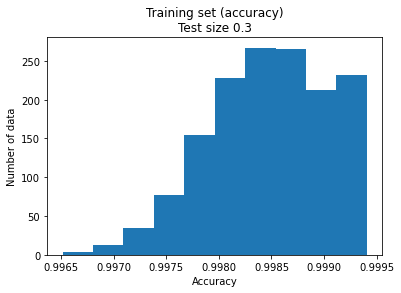

In [78]:
plt.hist(acc_train_list)
plt.title('Training set (accuracy)\nTest size 0.3')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
#plt.grid()
plt.show()

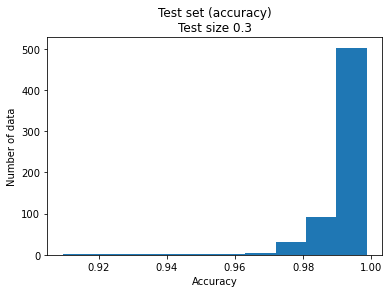

In [79]:
plt.hist(acc_test_list)
plt.title('Test set (accuracy)\nTest size 0.3')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
plt.show()

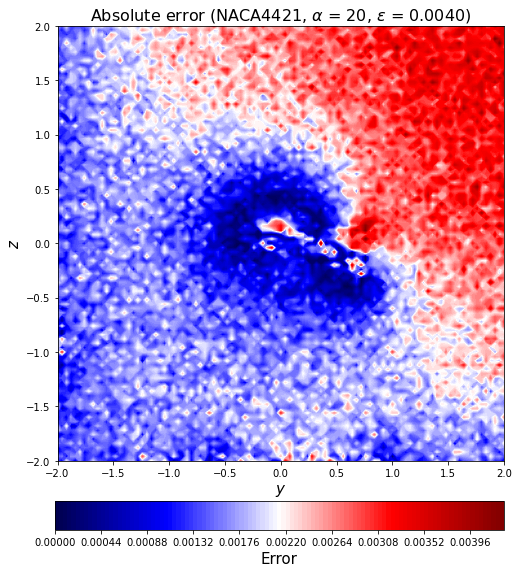

In [70]:
error_test_abs2_rotate = error_test_abs[-1].reshape(n_grid,n_grid).T

fig5 = plt.figure(figsize = (8, 8))
ax5 = fig5.add_subplot(111)
mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[-1])[3:-2],
                                                                   aa_test[-1], l2_error_test_list[-1]), fontsize=16)
ax5.set_xlabel('$y$', fontsize=15)
ax5.set_ylabel('$z$', fontsize=15)

cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
cbar.set_label('Error', fontsize=15)

save_fig_name = "20221027PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[-1])[3:-2])+str(aa_test[-1])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

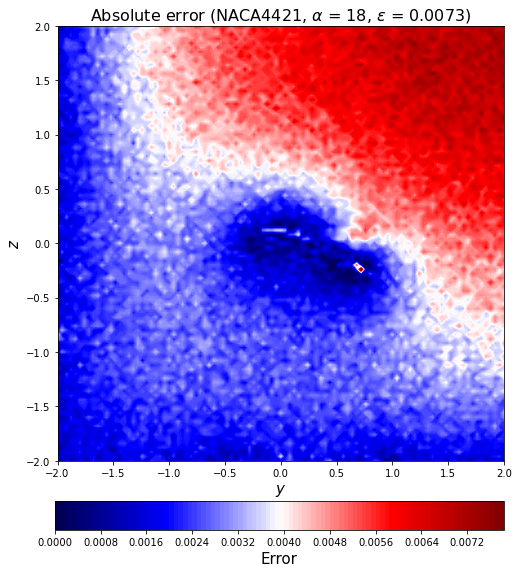

In [71]:
error_test_abs2_rotate = error_test_abs[-2].reshape(n_grid,n_grid).T

fig5 = plt.figure(figsize = (8, 8))
ax5 = fig5.add_subplot(111)
mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[-2])[3:-2],
                                                                   aa_test[-2], l2_error_test_list[-2]), fontsize=16)
ax5.set_xlabel('$y$', fontsize=15)
ax5.set_ylabel('$z$', fontsize=15)

cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
cbar.set_label('Error', fontsize=15)

save_fig_name = "20221027PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[-2])[3:-2])+str(aa_test[-2])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

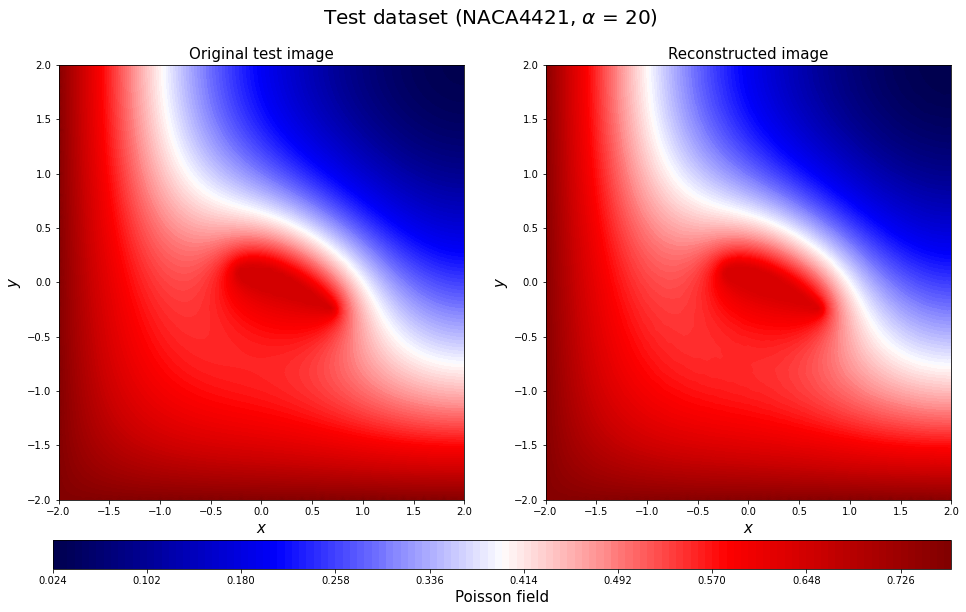

In [72]:
c=-1
plt.figure(figsize=(16, 8))
y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

xrange = np.linspace(-2, 2, n_grid)
yrange = np.linspace(-2, 2, n_grid)
xmesh, ymesh = np.meshgrid(xrange, yrange)

ax = plt.subplot(1, 2, 1)
a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Original test image', fontsize=15)

# Display reconstruction
ax = plt.subplot(1, 2, 2)
a2 = plt.contourf(xmesh, ymesh, decoded_rotate, levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Reconstructed image', fontsize=15)
cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
cbar.set_label('Poisson field', fontsize=15)
#cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
save_fig_name = "20221027Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

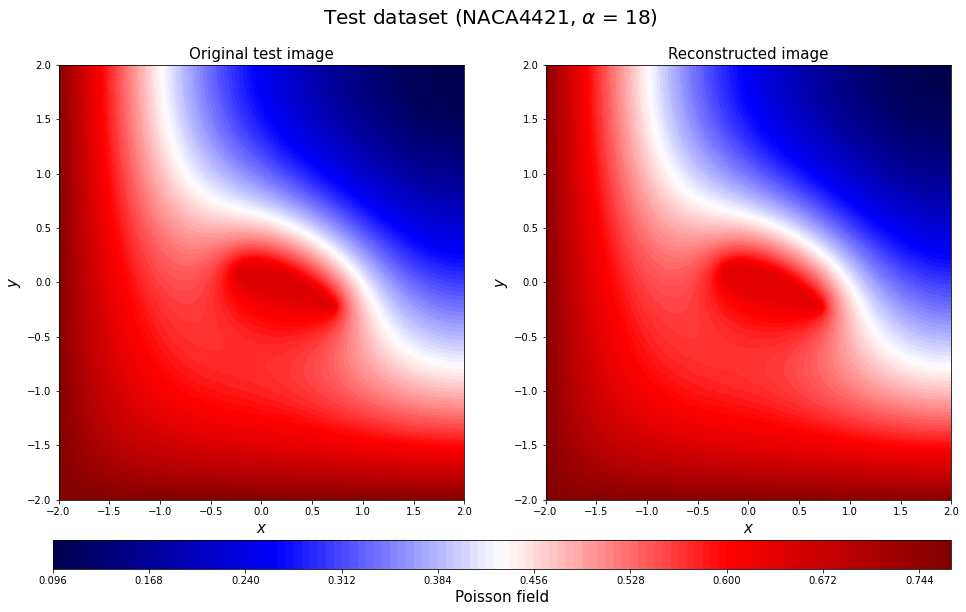

In [73]:
c=-2
plt.figure(figsize=(16, 8))
y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

xrange = np.linspace(-2, 2, n_grid)
yrange = np.linspace(-2, 2, n_grid)
xmesh, ymesh = np.meshgrid(xrange, yrange)

ax = plt.subplot(1, 2, 1)
a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Original test image', fontsize=15)

# Display reconstruction
ax = plt.subplot(1, 2, 2)
a2 = plt.contourf(xmesh, ymesh, decoded_rotate, levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Reconstructed image', fontsize=15)
cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
cbar.set_label('Poisson field', fontsize=15)
#cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
save_fig_name = "20221027Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

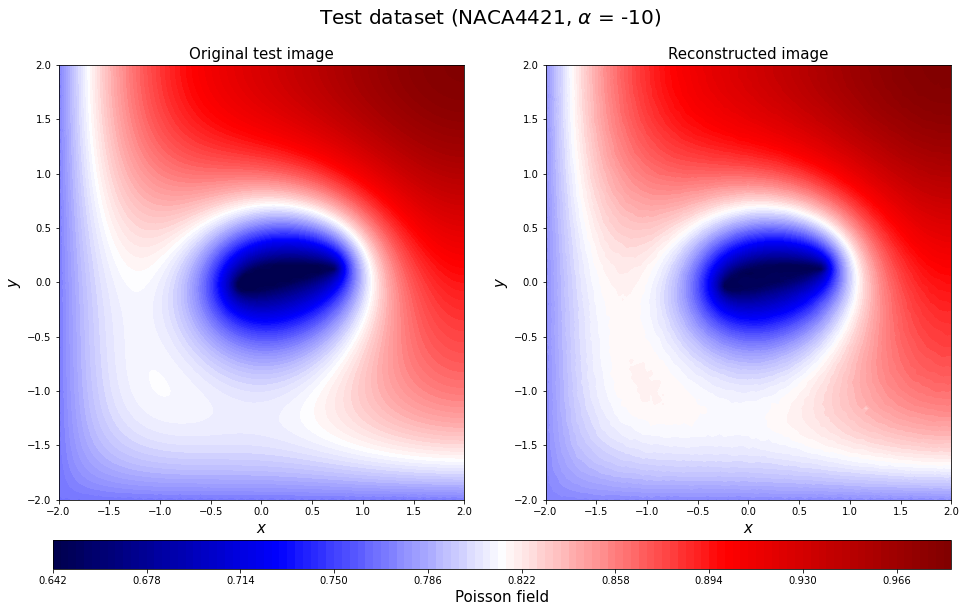

In [74]:
c=-16
plt.figure(figsize=(16, 8))
y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

xrange = np.linspace(-2, 2, n_grid)
yrange = np.linspace(-2, 2, n_grid)
xmesh, ymesh = np.meshgrid(xrange, yrange)

ax = plt.subplot(1, 2, 1)
a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Original test image', fontsize=15)

# Display reconstruction
ax = plt.subplot(1, 2, 2)
a2 = plt.contourf(xmesh, ymesh, decoded_rotate, levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Reconstructed image', fontsize=15)
cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
cbar.set_label('Poisson field', fontsize=15)
#cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
save_fig_name = "20221027Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

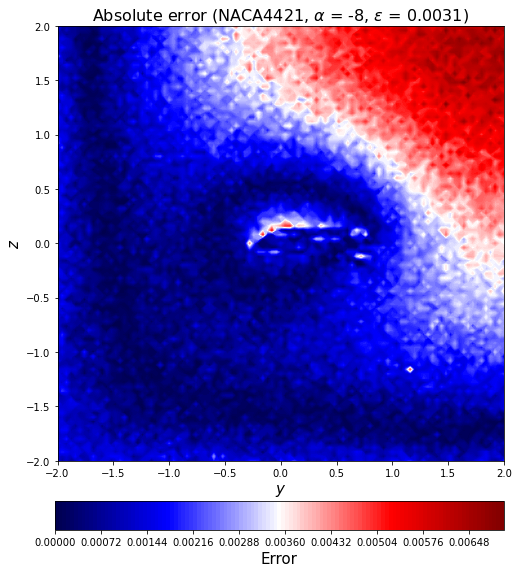

In [75]:
error_test_abs2_rotate = error_test_abs[-15].reshape(n_grid,n_grid).T

fig5 = plt.figure(figsize = (8, 8))
ax5 = fig5.add_subplot(111)
mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[-15])[3:-2],
                                                                   aa_test[-15], l2_error_test_list[-15]), fontsize=16)
ax5.set_xlabel('$y$', fontsize=15)
ax5.set_ylabel('$z$', fontsize=15)

cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
cbar.set_label('Error', fontsize=15)

save_fig_name = "20221027PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[-15])[3:-2])+str(aa_test[-15])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

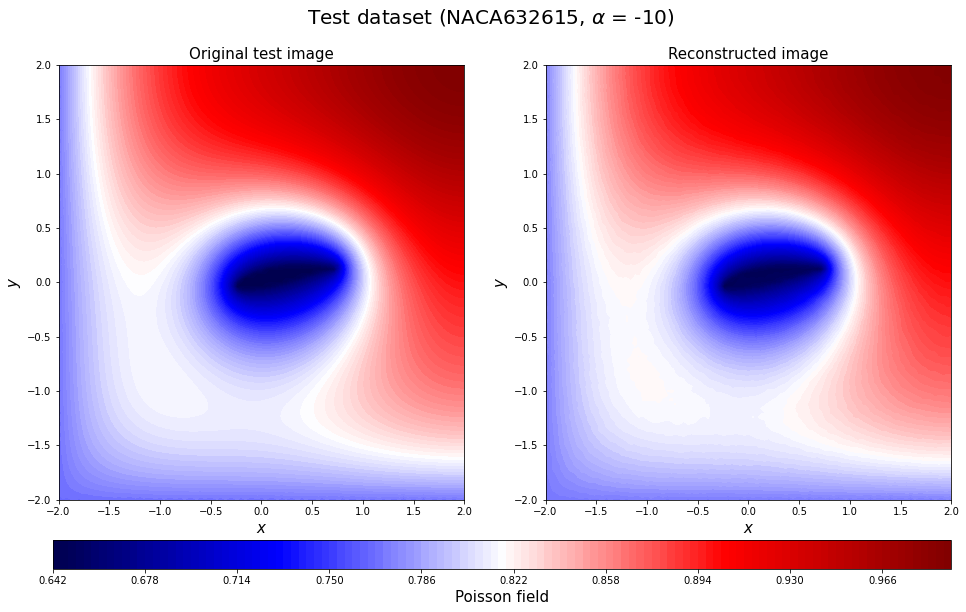

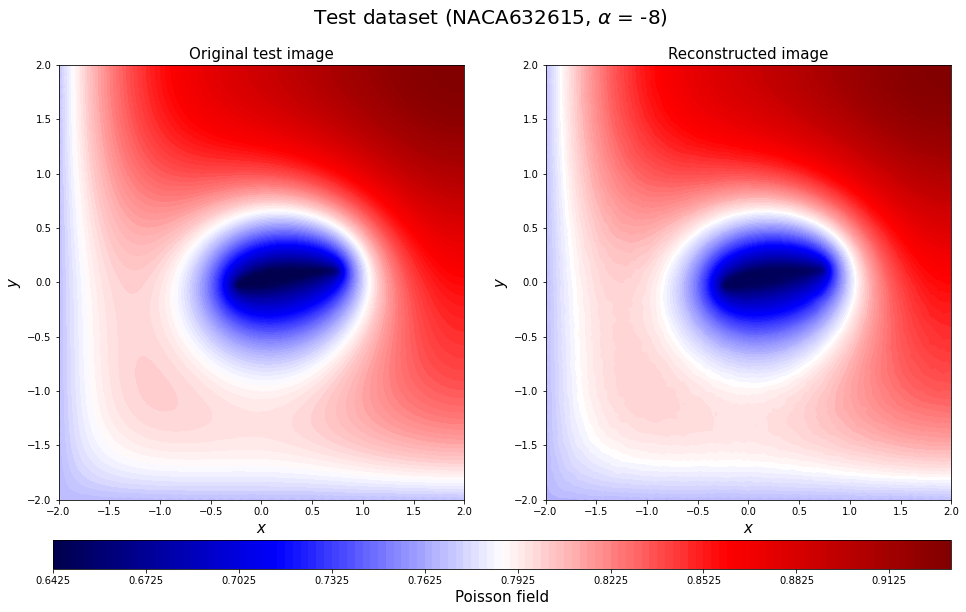

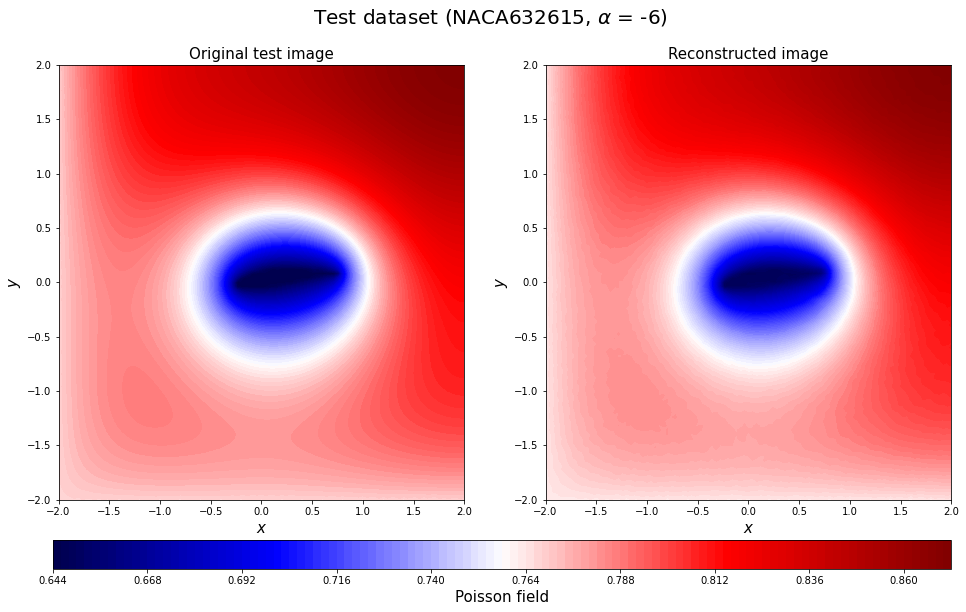

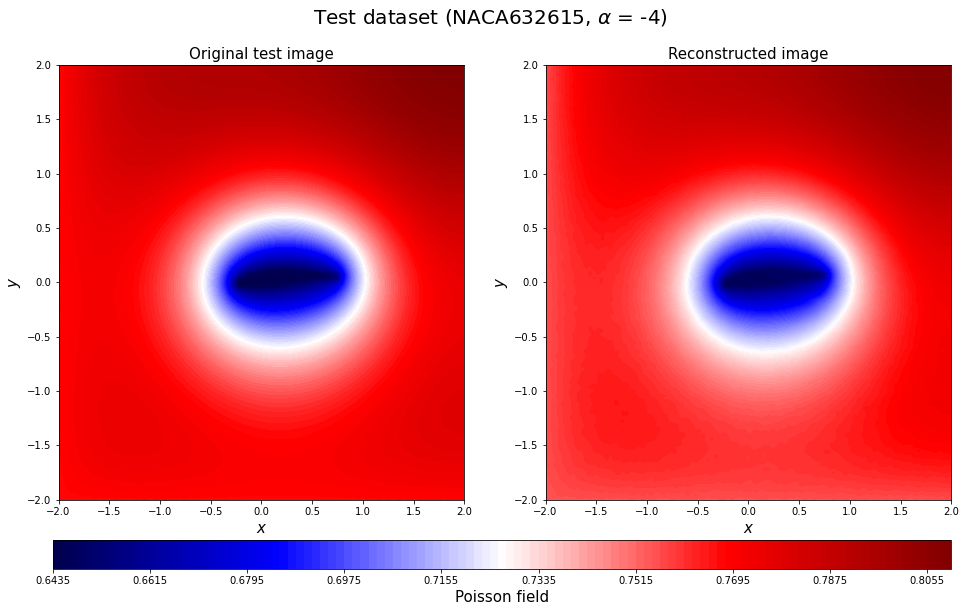

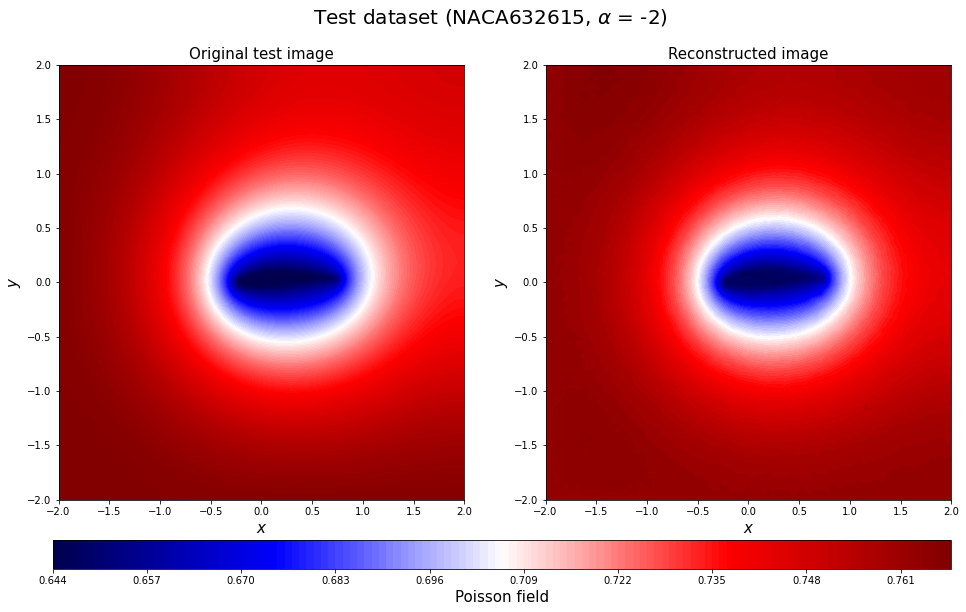

...

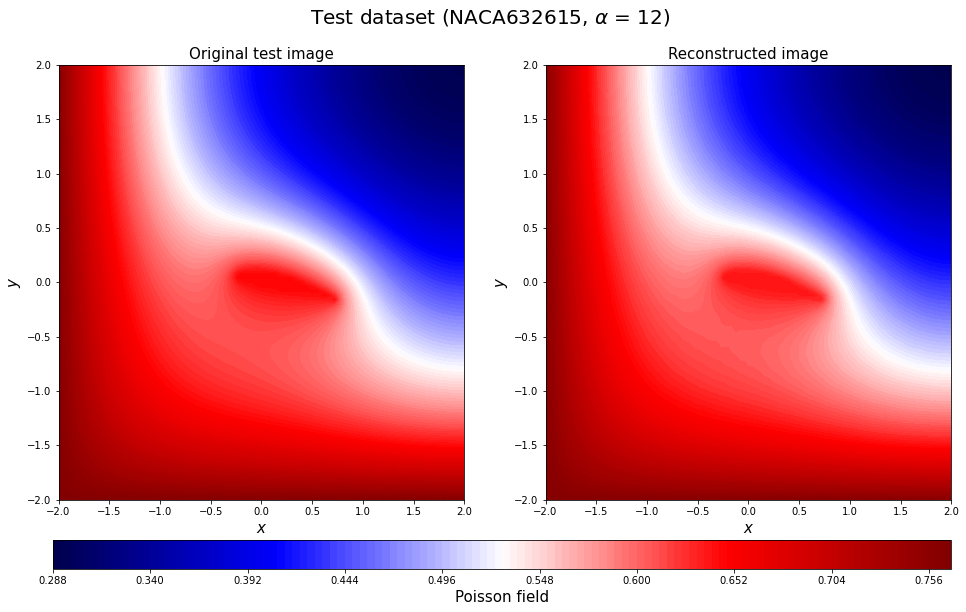

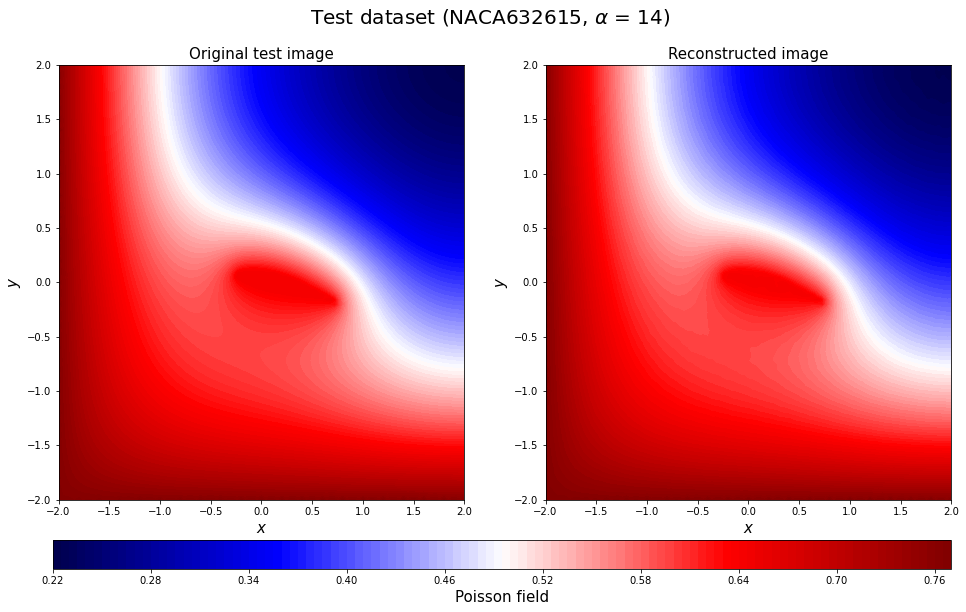

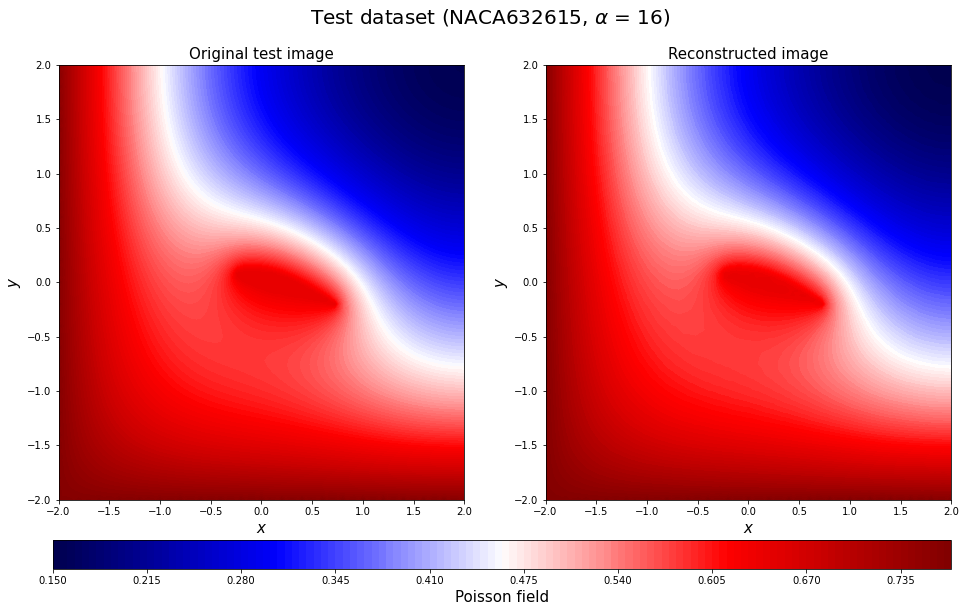

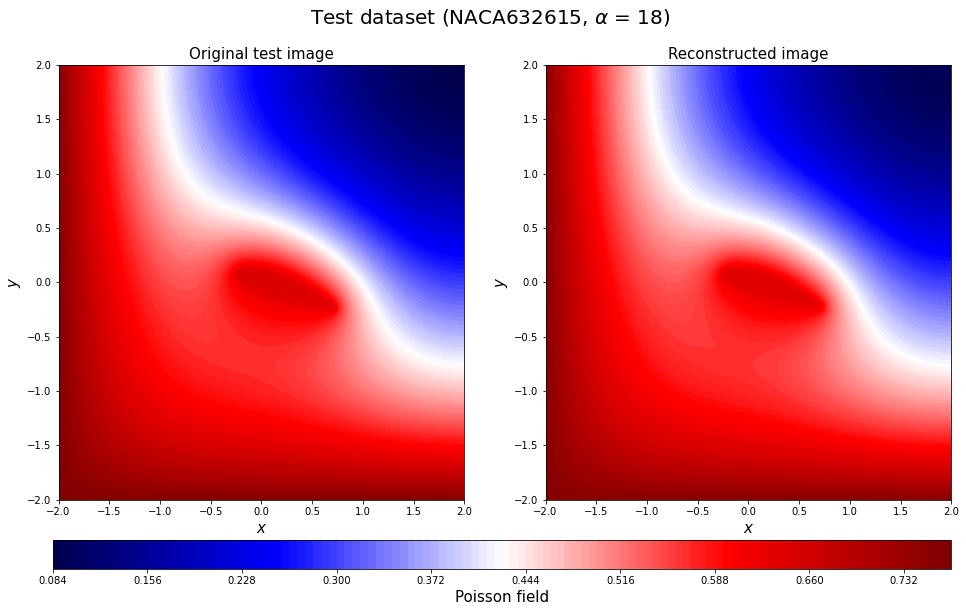

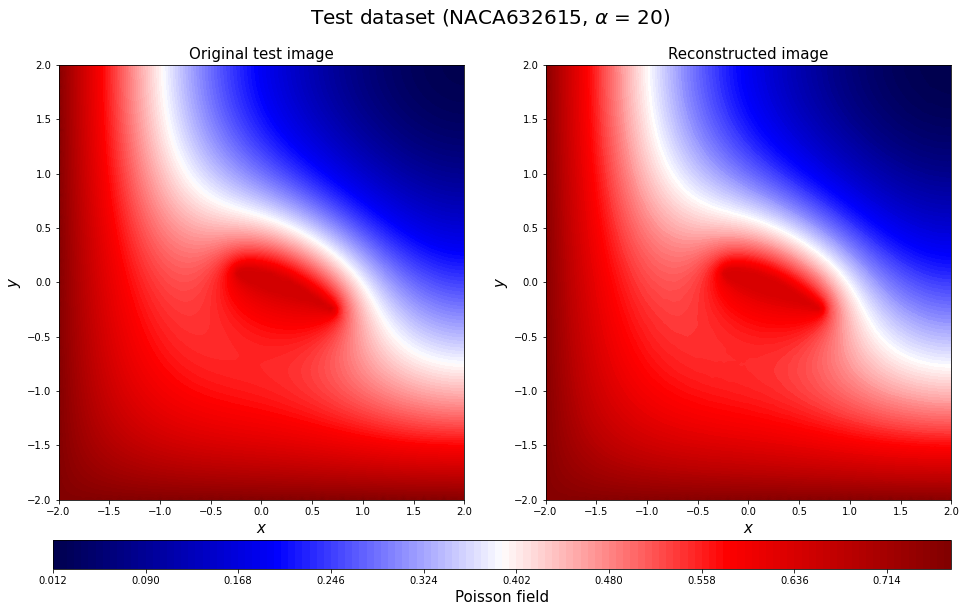

In [76]:
for c in range(96,112):
    plt.figure(figsize=(16, 8))
    y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
    save_fig_name = "20221027Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

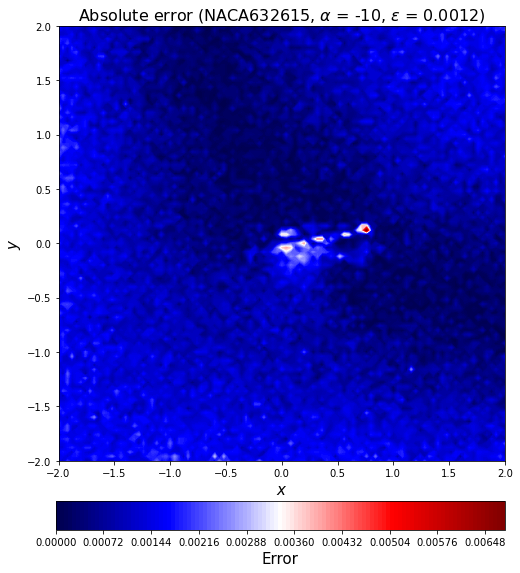

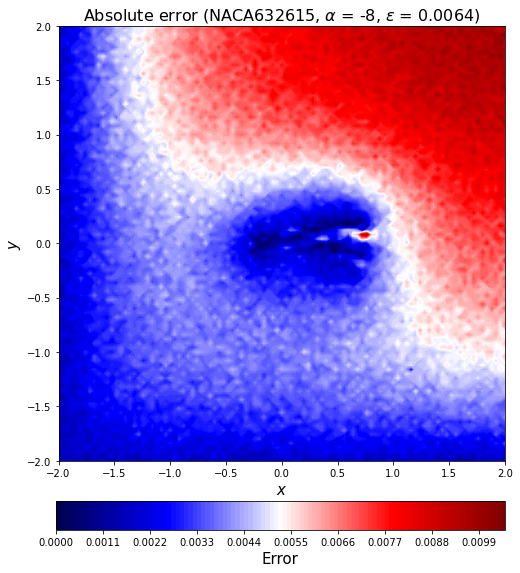

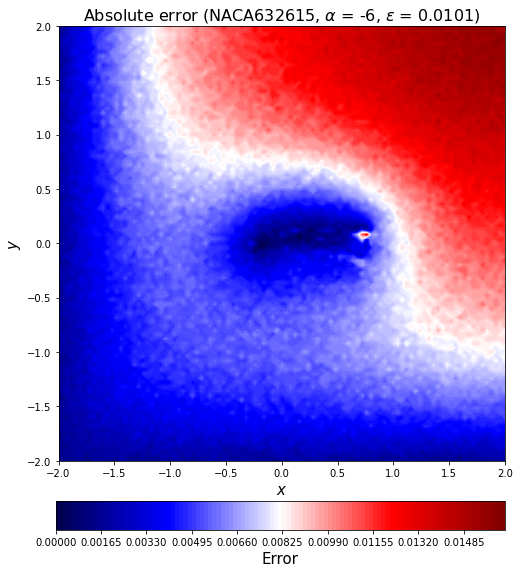

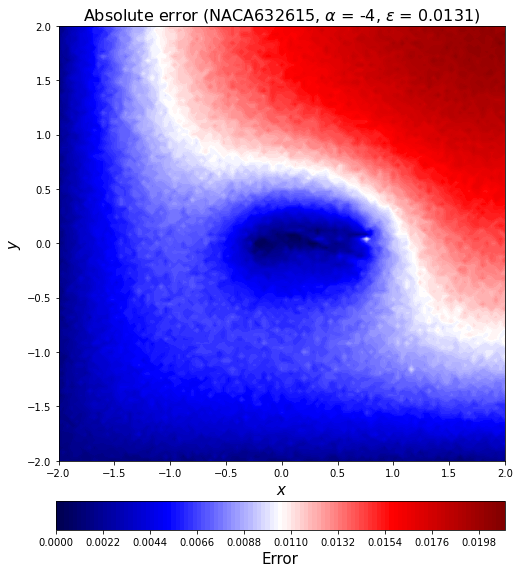

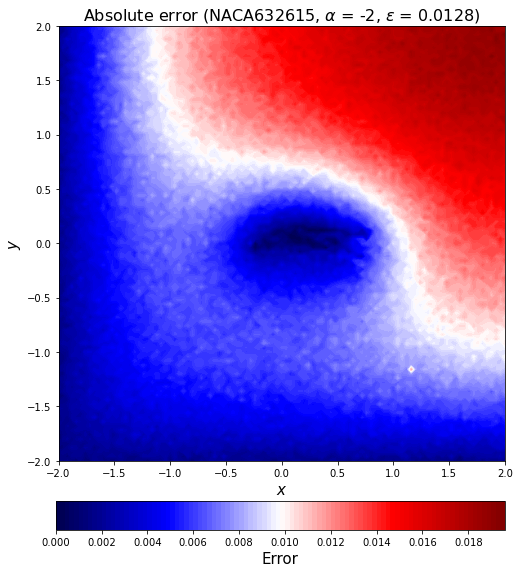

...

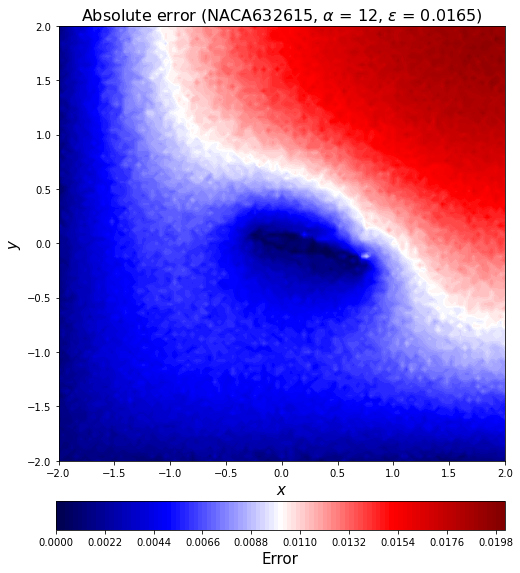

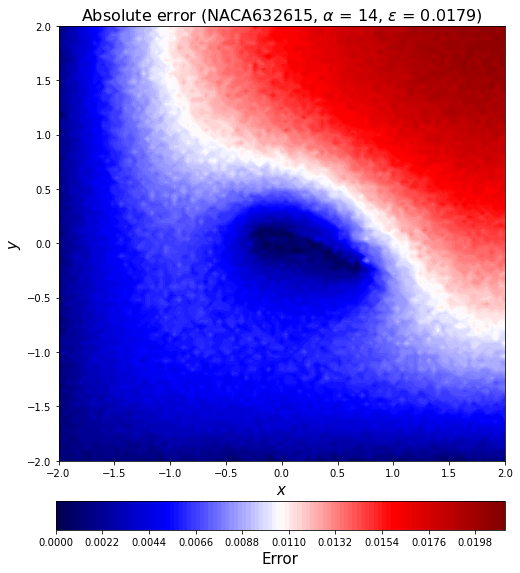

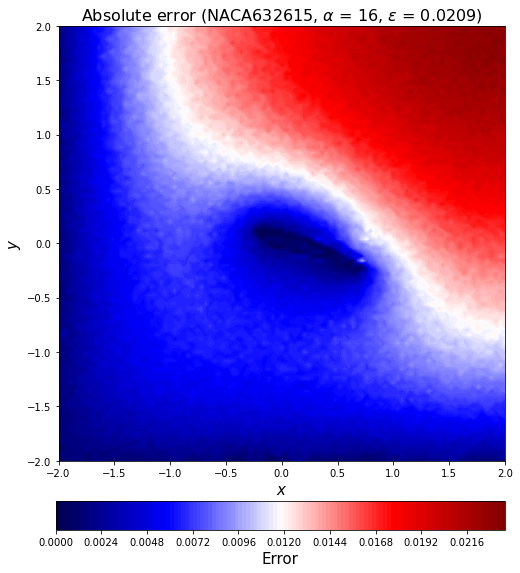

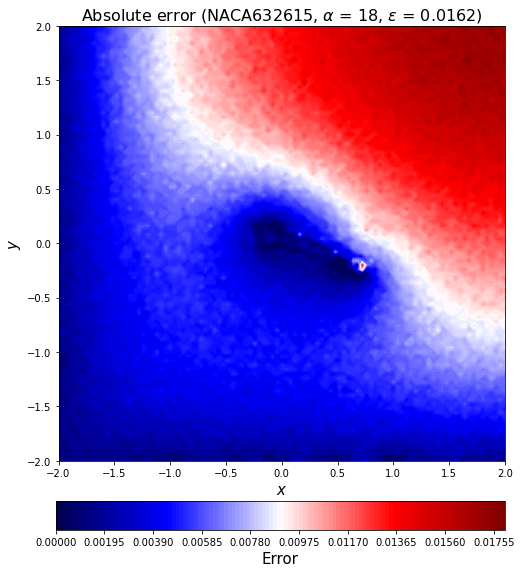

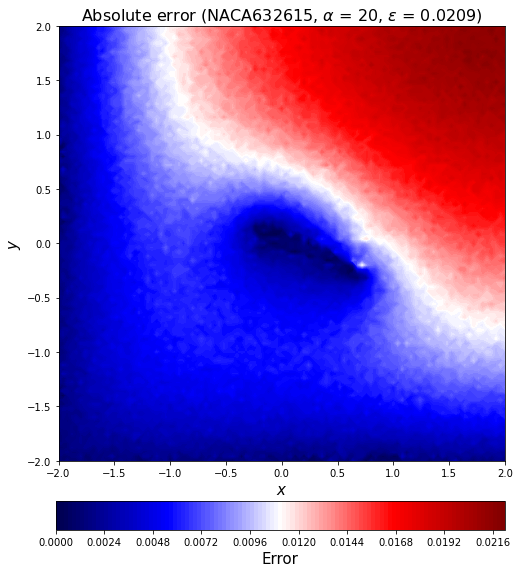

In [77]:
for c in range(96,112):
    error_test_abs2_rotate = error_test_abs[c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[c])[3:-2],
                                                                       aa_test[c], l2_error_test_list[c]), fontsize=16)
    ax5.set_xlabel('$x$', fontsize=15)
    ax5.set_ylabel('$y$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221027PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()